In [34]:
## Import Python libraries ## 

import numpy as np
import xsimlab as xs
import matplotlib.pyplot as plt
import xarray as xr


%matplotlib inline
%reload_ext xsimlab.ipython


import fastscape

from orographic_precipitation.fastscape_ext import precip_model
from fastscape.processes import Bedrock

In [35]:
print('xarray-simlab version: ', xs.__version__)
print('fastscape version: ', fastscape.__version__)

xarray-simlab version:  0.5.0
fastscape version:  0.1.0


In [36]:
## Build xarray-simlab model ##
SouthernAndesLEM = precip_model
SouthernAndesLEM = precip_model.drop_processes(['init_topography'])
SouthernAndesLEM = SouthernAndesLEM.update_processes({'bedrock': Bedrock})

SouthernAndesLEM

<xsimlab.Model (17 processes, 26 inputs)>
grid
    shape                  [in] ('shape_yx',) nb. of grid nodes in ...
    length                 [in] ('shape_yx',) total grid length in ...
boundary
    status                 [in] () or ('border',) node status at bo...
fs_context
uplift
    rate                   [in] () or ('y', 'x') uplift rate
tectonics
surf2erode
init_erosion
diffusion
    diffusivity            [in] () or ('y', 'x') diffusivity (trans...
flow
orographic
    lapse_rate             [in] environmental lapse rate
    lapse_rate_m           [in] moist adiabatic lapse rate
    ref_density            [in] reference saturation water vapor de...
    latitude               [in] latitude
    precip_base            [in] () or ('y', 'x') background, non-or...
    rainfall_frequency  [inout] daily rainfall frequency
    wind_speed             [in] wind speed
    wind_dir               [in] wind direction (azimuth)
    conv_time              [in] conversion time
    fall_time    

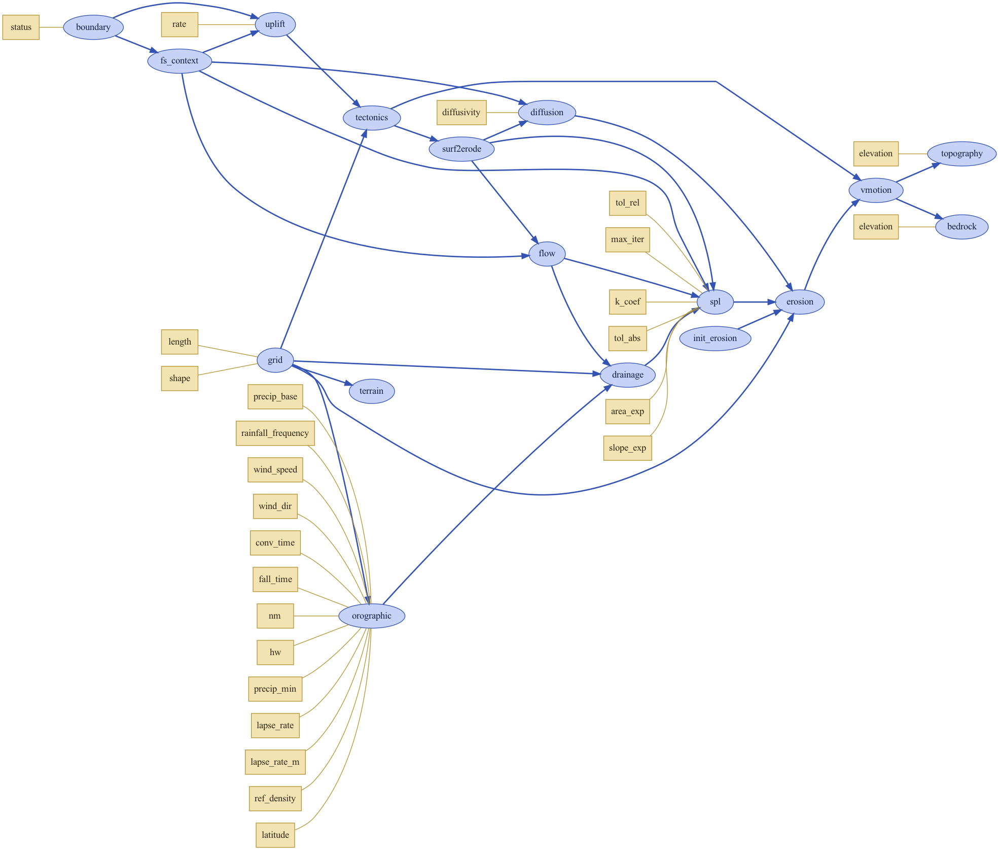

In [37]:
## Visualise xarray-simlab ##
SouthernAndesLEM.visualize(show_inputs='True')

In [38]:
## Model dimensions/grid dimensions ##
nx = 100
ny = 100
nn = nx * ny

xl = 100.e3
yl = 100.e3

BoundaryCondition = ['looped', 'looped', 'fixed_value', 'fixed_value']

## Model time and time stepping ##
EndTime_1 = 5e6
EndTime_2 = 5e6
EndTime_3 = 8e6
TimeSteps_1 = 10001
TimeSteps_2 = 10001
TimeSteps_3 = 16001

# EndTime = 1e6
# TimeSteps = 1001
ModelTime_1 = np.linspace(0., EndTime_1, TimeSteps_1)
ModelTime_2 = np.linspace(0., EndTime_2, TimeSteps_2)
ModelTime_3 = np.linspace(0., EndTime_3, TimeSteps_3)

PlotStep = 100

## Tectonics ##
k_coef= 2.5e-5
area_exp = 0.4
slope_exp = 1.0
diffusion_diffusivity = 0.


## Orographic ##
lapse_rate = -5.4 #mean lapse rate of area not too far away 
lapse_rate_m = -6.5 #left default
ref_density = 7.4e-3  #left default
rainfall_frequency = 5 #could not find high resolution data for hourly rainfall in the area of patagonia i was interested in looking at so just and estimate
latitude = 46  #latitude around the area north in the Patagonian Andes
precip_base =  1e-4 #not sure if I should change this or not
wind_speed = 10 #base to start with 
wind_dir = 270  # estimated direction given weather info 
precip_min = 0.1 #chatgpt value so could be wrong
conv_time = 2000 #2000 thesis value
fall_time = 2000 #2000 thesis value
nm = 0.003  #0.03 #thesis value
hw = 5000  #


## Initial topography ##
WhiteNoiseLevel = 50 # in [m], amplitude of noise

## Seed for Reproducibility ##
RandomSeed = 1410

In [39]:
import numpy as np
import matplotlib.pyplot as plt

# Define grid size
nx, ny = 100, 100  # Example values; adjust as needed
nn = nx * ny  # Total number of nodes

# Initialize an array to store elevations
InitialTopography = np.zeros(nn)

# Assign elevations based on node indices (using slicing and grid structure)
InitialTopography[:int(0.25 * nn)] = 400    # First 25% of nodes
InitialTopography[int(0.25 * nn):int(0.5 * nn)] = 3375  # Next 25% of nodes
InitialTopography[int(0.5 * nn):int(0.75 * nn)] = 2500  # Next 25% of nodes
InitialTopography[int(0.75 * nn):] = 1000  # Last 25% of nodes

# Adding random noise to the elevations
np.random.seed(42)  # For reproducibility
WhiteNoiseLevel = 50  # Standard deviation of noise
Noise = np.random.normal(0, WhiteNoiseLevel, nn)
InitialTopography += Noise  # Add noise to the elevations

# Reshape the 1D array to 2D with shape (ny, nx)
InitialTopography_2D = InitialTopography.reshape((ny, nx))

# Define first stage uplift rates for each region
UpliftRates = np.zeros(nn)  # Initialize uplift rates array

# Assign uplift rates to regions (using slicing or fractions of the total nodes)
UpliftRates[:int(0.25 * nn)] = 0.01    # First 25% of nodes
UpliftRates[int(0.25 * nn):int(0.5 * nn)] = 0.041  # Next 25% of nodes
UpliftRates[int(0.5 * nn):int(0.75 * nn)] = 0.035  # Next 25% of nodes
UpliftRates[int(0.75 * nn):] = 0.02  # Last 25% of nodes

# Adding random noise to the uplift rates for realism (optional)
np.random.seed(42)  # For reproducibility
UpliftNoise = np.random.normal(0, 0.005, nn)  # Small noise in uplift rates
UpliftRates += UpliftNoise  # Add noise to the uplift rates

# Reshape the 1D array to 2D with shape (ny, nx)
UpliftRates_2D = UpliftRates.reshape((ny, nx))

# Rotate both topography and uplift rates 90 degrees anti-clockwise
RotatedTopography_2D = np.rot90(InitialTopography_2D, k=1)
RotatedUpliftRates_2D = np.rot90(UpliftRates_2D, k=1)

In [40]:
import os

# Directory to save Zarr files
output_dir = "simulation_outputs"
os.makedirs(output_dir, exist_ok=True)

# Define wind_speed values to test
wind_speed_values = np.linspace(10, 100, 10)  # 10 to 100

# Time steps to visualize
time_indices = [0, 1, 10, 100, 1000, 10000]
mean_elevations = []

# Loop through wind_speed values and run simulations
for wind_speed in wind_speed_values:
    print(f"Running simulation for wind_speed = {wind_speed} m/s")
    
    # Set up the model with the current wind_speed (same as before)
    in_ds_winds = xs.create_setup(
        model=SouthernAndesLEM,
        clocks={
            'time': ModelTime_1,
            'output': ModelTime_1[::PlotStep]
        },
        master_clock='time',
        input_vars={
            'grid': {'shape': [nx, ny], 'length': [xl, yl]},
            'boundary': {'status': BoundaryCondition},
            'topography': {'elevation': RotatedTopography_2D},
            'bedrock': {'elevation': RotatedTopography_2D},
            'uplift': {'rate': RotatedUpliftRates_2D},
            'spl': {'k_coef': k_coef, 'area_exp': area_exp, 'slope_exp': slope_exp},
            'diffusion': {'diffusivity': diffusion_diffusivity},
            'orographic': {
                'lapse_rate': lapse_rate,
                'lapse_rate_m': lapse_rate_m,
                'ref_density': ref_density,
                'rainfall_frequency': rainfall_frequency,
                'latitude': latitude,
                'precip_base': precip_base,
                'wind_speed': wind_speed,  # Change wind speed
                'wind_dir': wind_dir,
                'precip_min': precip_min,
                'conv_time': conv_time,
                'fall_time': fall_time,
                'nm': nm,
                'hw': hw,
            },
        },
        output_vars={'topography__elevation': 'time', 'orographic__precip_rate': 'time'}
    )

    # Run the simulation
    with xs.monitoring.ProgressBar():
        out_ds_winds = in_ds_winds.xsimlab.run(model=SouthernAndesLEM)
    
    # Store simulation results in Zarr format
    zarr_filename = os.path.join(output_dir, f"simulation_wind_speed_{wind_speed:.2f}.zarr")
    out_ds_winds.to_zarr(zarr_filename, mode='w')
    print(f"Saved results for wind_speed = {wind_speed} m/s to {zarr_filename}")


Running simulation for wind_speed = 10.0 m/s


             0% | initialize 

KeyboardInterrupt: 

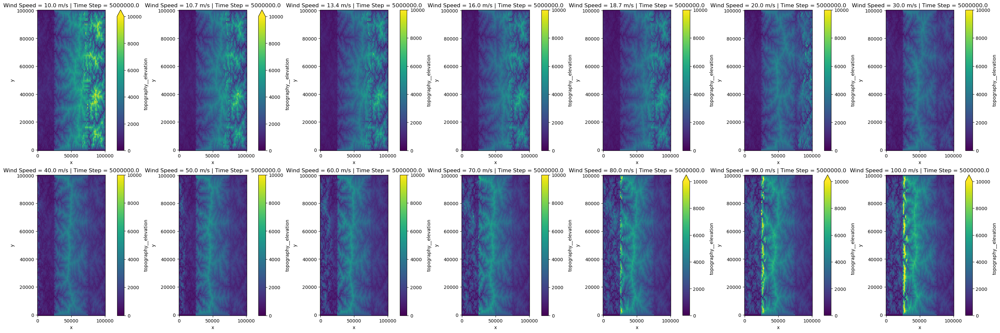

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))  # Extract wind speed from filename

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if 10 <= wind_speed <= 100:  # Filter wind speeds between 10 and 100 m/s
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

### 📌 Plot: Elevation Maps for Different Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=2, ncols=(len(wind_speeds) + 1) // 2, figsize=(30, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_WindSpeeds_Filtered.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


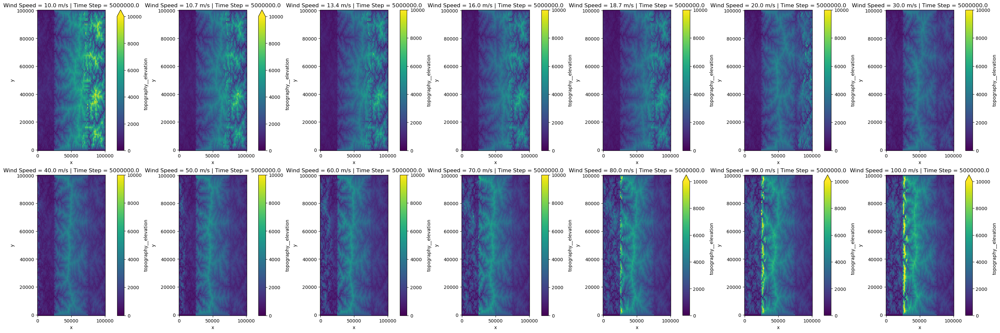

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))  # Sort by wind speed (assumed to be in the filename)

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if 10 <= wind_speed <= 100:  # Filter wind speeds between 10 and 100 m/s
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Calculate the number of rows and columns based on the number of plots
num_plots = len(wind_speeds)
num_cols = (num_plots + 1) // 2  # Number of columns (2 per row)
num_rows = (num_plots + num_cols - 1) // num_cols  # Ensure we cover all plots

# 📌 Plot: Elevation Maps for Different Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 10), constrained_layout=True)  # Fixed width for each plot
axes = axes.flatten()

# Loop over datasets and create plots
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_WindSpeeds_Filtered.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_directions = []
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if 10 <= wind_speed <= 100:  # Filter wind directions between 10 and 100
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_directions.append(wind_speed)
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

### 📌 Plot: Elevation Maps for Different Wind spped values at Final Time Step
fig, axes = plt.subplots(nrows=2, ncols=(len(wind_speed) + 1) // 2, figsize=(30, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_directions, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Dir = {wind_speed:.1f}m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speed), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_windspeed_Filtered.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()

TypeError: object of type 'float' has no len()

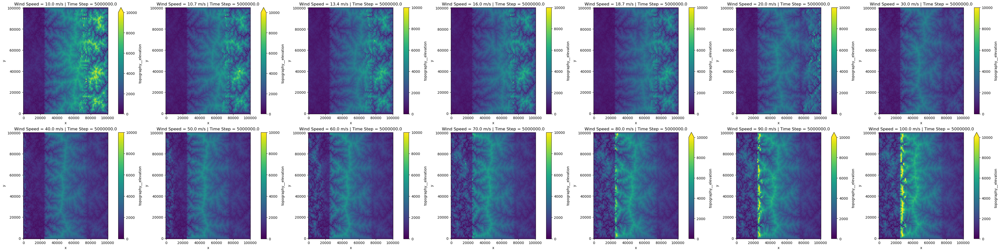

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []  # Changed to wind_speeds to hold a list of all wind speeds
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if 10 <= wind_speed <= 100:  # Filter wind speeds between 10 and 100
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)  # Append wind_speed to the list
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Calculate the number of rows and columns based on the number of wind speeds
num_plots = len(wind_speeds)
num_cols = (num_plots + 1) // 2  # Number of columns (2 per row)
num_rows = (num_plots + num_cols - 1) // num_cols  # Ensure we cover all plots

# 📌 Plot: Elevation Maps for Different Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(40, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()

# Loop over datasets and create plots
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_WindSpeed_Filtered.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


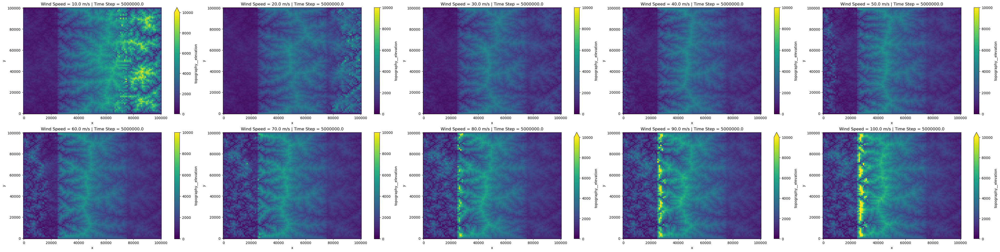

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Specify the wind speeds you want to plot
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []  # This will hold the filtered wind speeds
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if wind_speed in desired_wind_speeds:  # Filter based on the desired wind speeds
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)  # Append only the desired wind speeds
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Calculate the number of rows and columns based on the number of wind speeds
num_plots = len(wind_speeds)
num_cols = (num_plots + 1) // 2  # Number of columns (2 per row)
num_rows = (num_plots + num_cols - 1) // num_cols  # Ensure we cover all plots

# 📌 Plot: Elevation Maps for Selected Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(40, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()

# Loop over datasets and create plots
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_WindSpeed_Selected.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


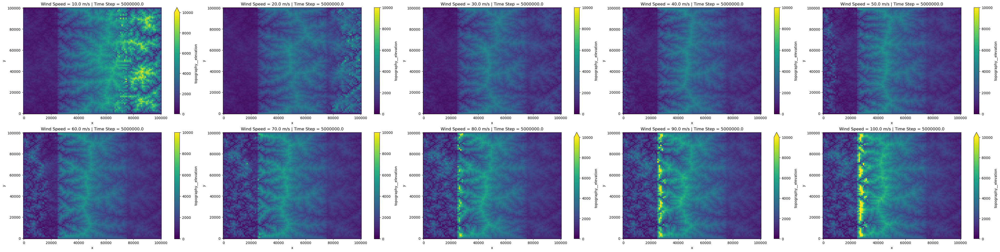

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Define the specific wind speeds to plot
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if wind_speed in desired_wind_speeds:  # Only include the desired wind speeds
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)  # Append only desired wind speeds
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Calculate the number of rows and columns based on the number of wind speeds
num_plots = len(wind_speeds)
num_cols = (num_plots + 1) // 2  # Number of columns (2 per row)
num_rows = (num_plots + num_cols - 1) // num_cols  # Ensure we cover all plots

# 📌 Plot: Elevation Maps for Selected Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(40, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()

# Loop over datasets and create plots
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_WindSpeed_Selected.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


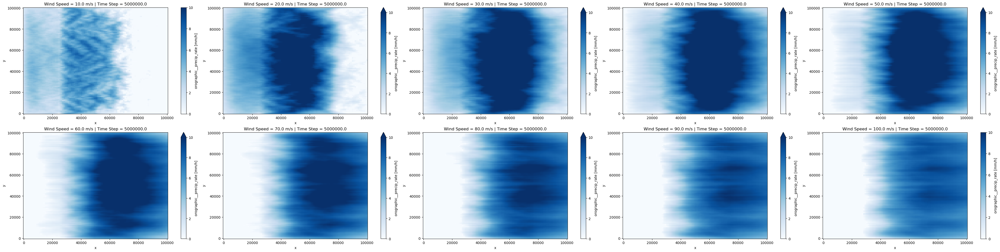

In [ ]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Define the specific wind speeds to plot
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if wind_speed in desired_wind_speeds:  # Only include the desired wind speeds
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)  # Append only desired wind speeds
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Calculate the number of rows and columns based on the number of wind speeds
num_plots = len(wind_speeds)
num_cols = (num_plots + 1) // 2  # Number of columns (2 per row)
num_rows = (num_plots + num_cols - 1) // num_cols  # Ensure we cover all plots

# 📌 Plot: Precipitation Maps for Selected Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(40, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()

# Loop over datasets and create plots
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    # Plot precipitation at the final time step
    precip_data = ds.orographic__precip_rate.isel(time=-1)
    precip_data.plot(ax=ax, vmin=0, vmax=10, cmap='Blues')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Precipitation_WindSpeed_Selected.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


  - Max precipitation at final time: 8.16 mm/hr


<Figure size 1200x800 with 0 Axes>

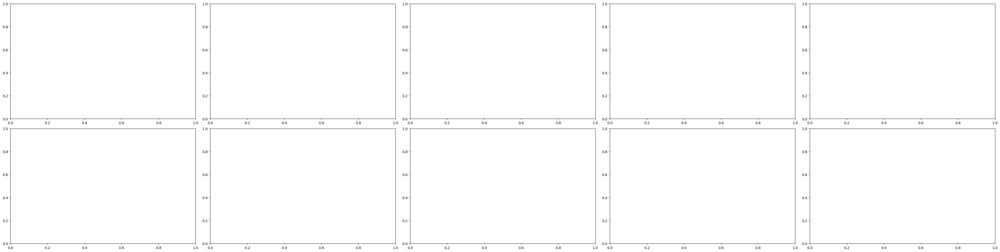

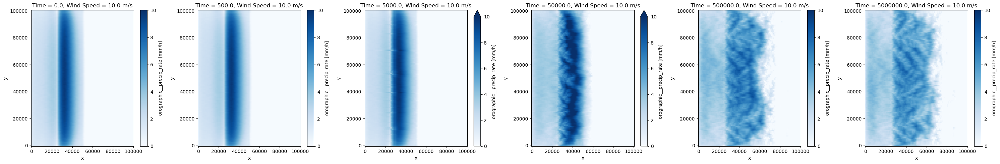

  - Max precipitation at final time: 13.48 mm/hr


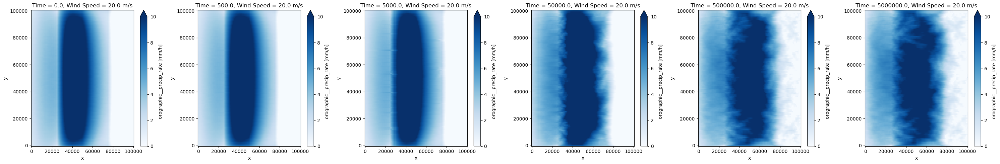

  - Max precipitation at final time: 14.61 mm/hr


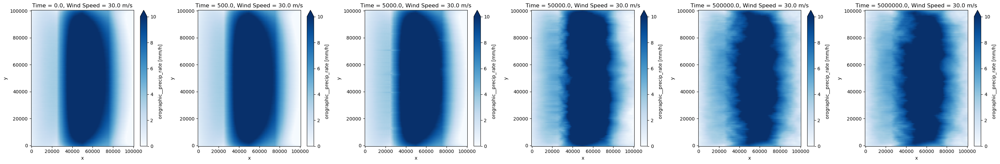

  - Max precipitation at final time: 14.06 mm/hr


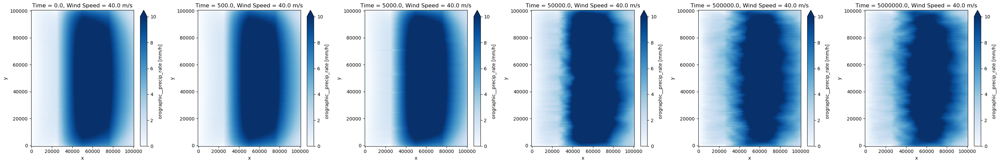

  - Max precipitation at final time: 12.98 mm/hr


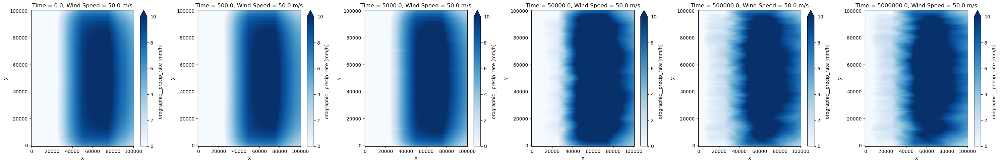

  - Max precipitation at final time: 12.21 mm/hr


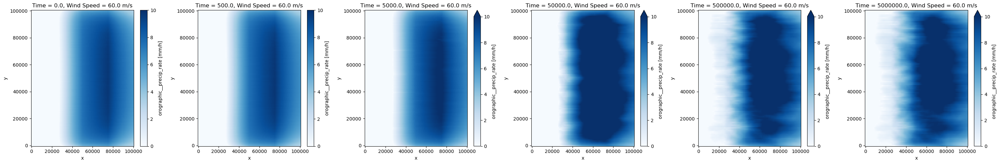

  - Max precipitation at final time: 11.56 mm/hr


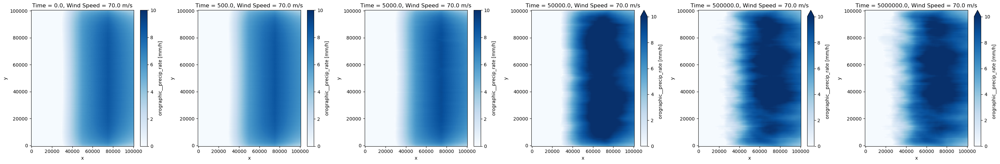

  - Max precipitation at final time: 10.72 mm/hr


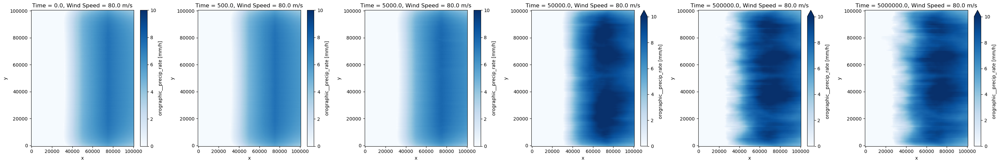

  - Max precipitation at final time: 10.04 mm/hr


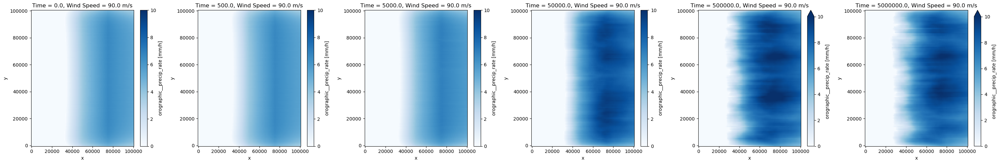

  - Max precipitation at final time: 9.61 mm/hr


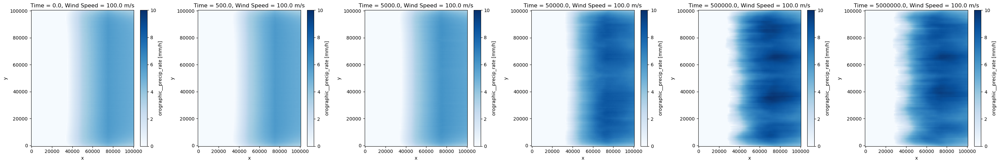

In [ ]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Define the wind speeds of interest
target_wind_speeds = {10, 20, 30, 40, 50, 60, 70, 80, 90, 100}

# Load datasets
datasets = [xr.open_zarr(os.path.join(output_dir, f), chunks={}) for f in zarr_files]

# Time steps to visualize
time_indices = [0, 1, 10, 100, 1000, 10000]

# Function to plot orographic precipitation maps
def plot_precipitation(out_ds_winds, wind_speed):
    # Extract precipitation data at selected time indices
    precip_data = out_ds_winds.orographic__precip_rate.isel(time=time_indices)

    # Print sample numerical outputs
    print(f"  - Max precipitation at final time: {precip_data.isel(time=-1).max().values:.2f} mm/hr")

    # Plot precipitation over time
    fig, axes = plt.subplots(1, len(time_indices), figsize=(30, 5))
    for i, ax in enumerate(axes):
        precip_data.isel(time=i).plot(ax=ax, vmin=0, vmax=10, cmap='Blues')
        ax.set_title(f"Time = {precip_data.time[i].values}, Wind Speed = {wind_speed:.1f} m/s")
    plt.tight_layout()
    plt.savefig(f"Precipitation_WindSpeed_{wind_speed:.2f}.png")
    plt.show()

# Loop through datasets and process each one
for ds, zarr_file in zip(datasets, zarr_files):
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename

    # Only process the datasets that match the target wind speeds
    if wind_speed in target_wind_speeds:
        # Call function to plot precipitation maps
        plot_precipitation(ds, wind_speed)

# Close all datasets
for ds in datasets:
    ds.close()


  - Mean elevation at final time: 9805.45 m
  - Max precipitation at final time: 26.07 mm/hr


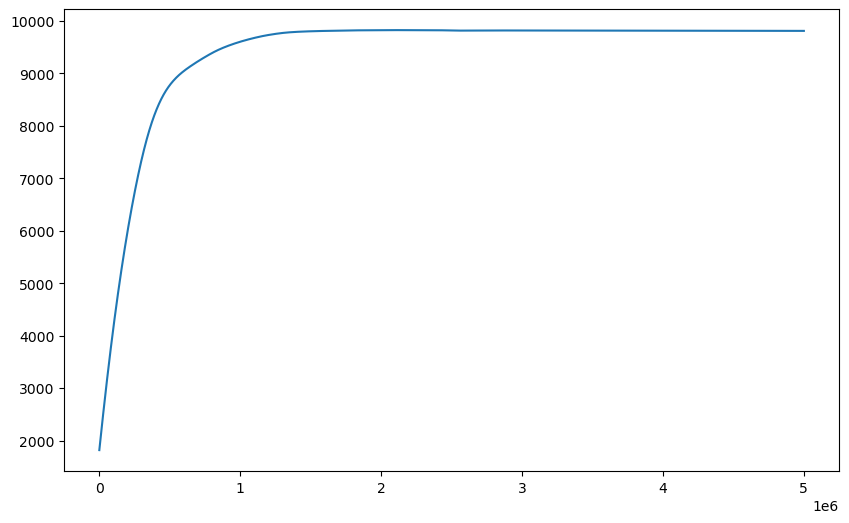

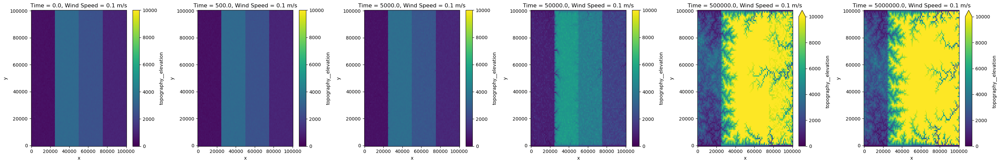

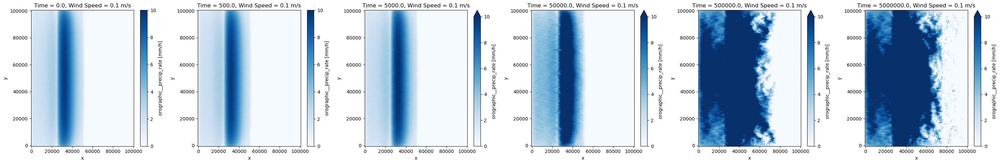

  - Mean elevation at final time: 3815.63 m
  - Max precipitation at final time: 9.60 mm/hr


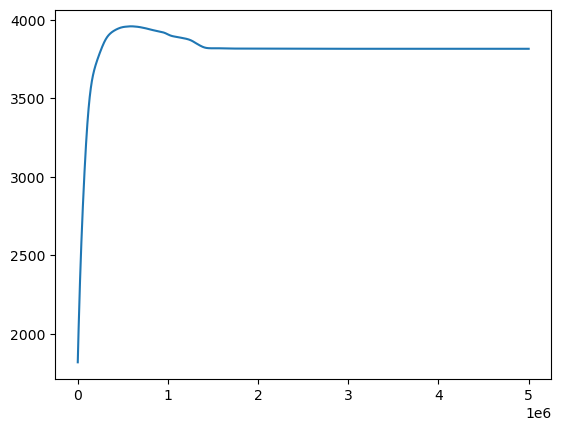

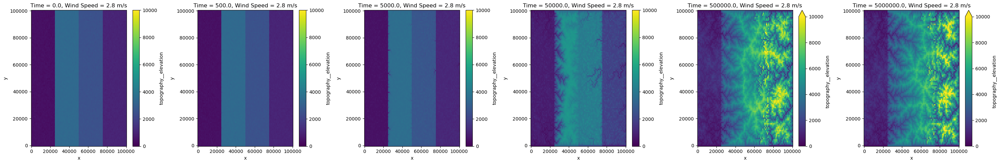

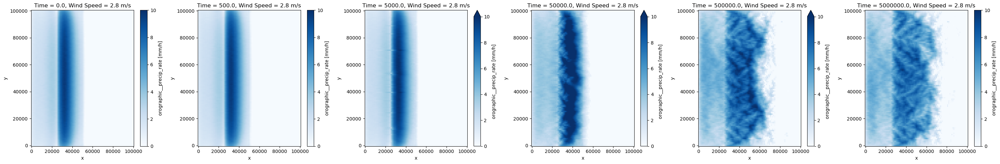

  - Mean elevation at final time: 3188.39 m
  - Max precipitation at final time: 7.90 mm/hr


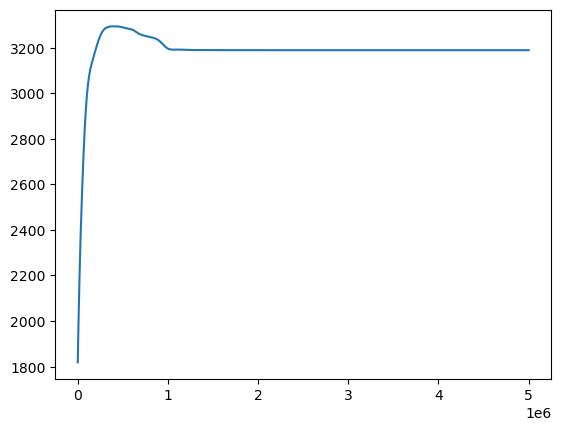

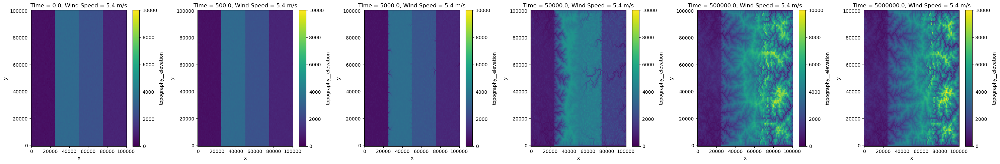

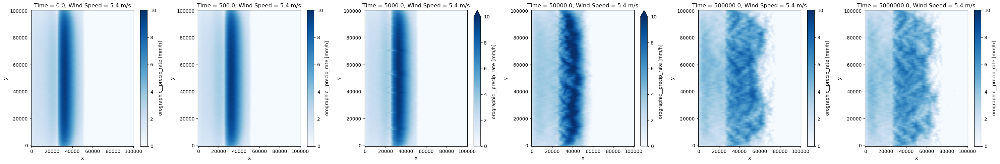

  - Mean elevation at final time: 3249.57 m
  - Max precipitation at final time: 8.16 mm/hr


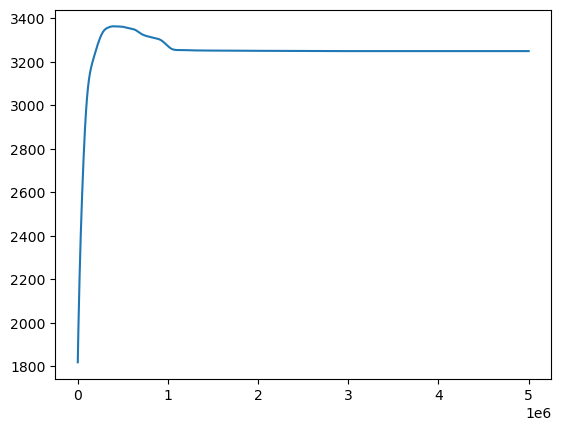

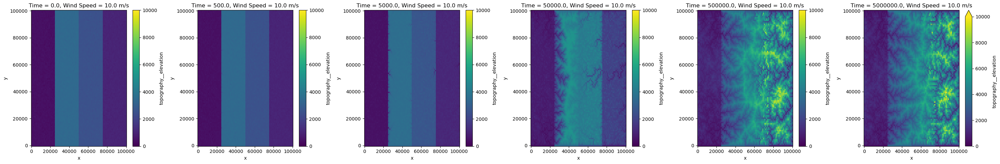

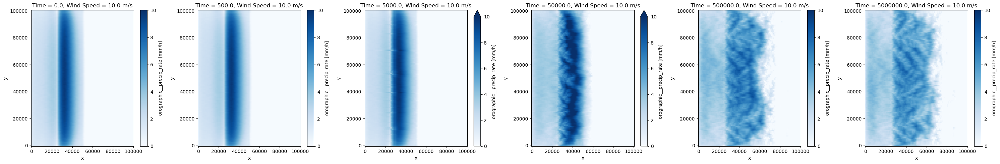

  - Mean elevation at final time: 2321.67 m
  - Max precipitation at final time: 13.48 mm/hr


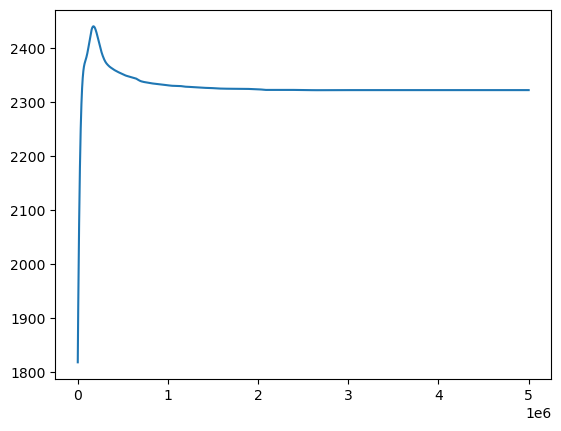

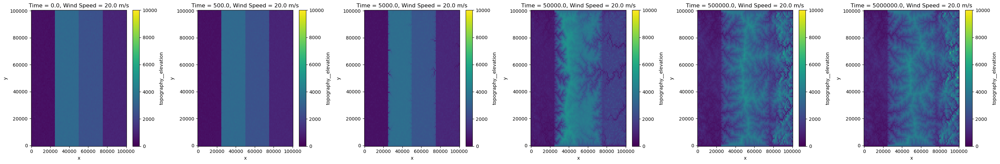

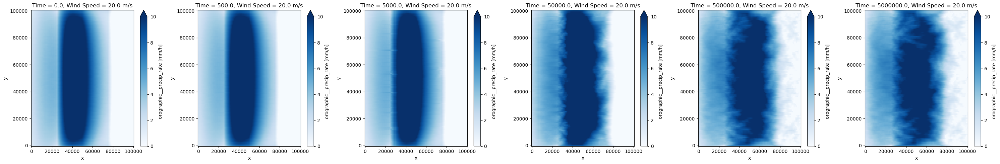

  - Mean elevation at final time: 2043.31 m
  - Max precipitation at final time: 14.61 mm/hr


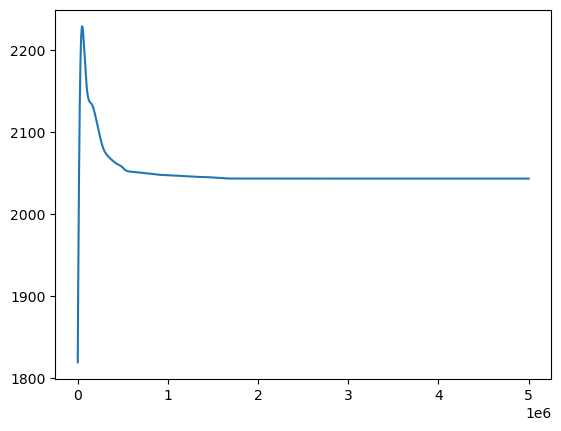

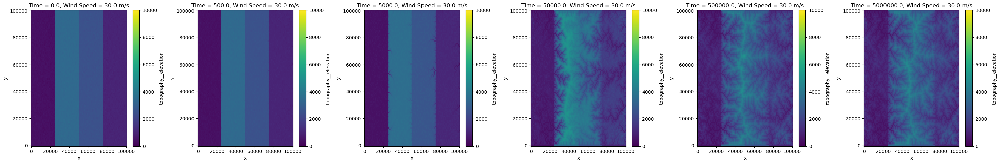

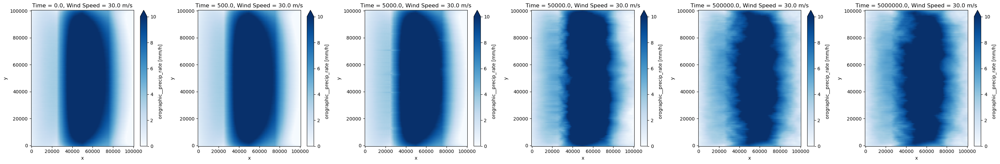

  - Mean elevation at final time: 2076.63 m
  - Max precipitation at final time: 14.06 mm/hr


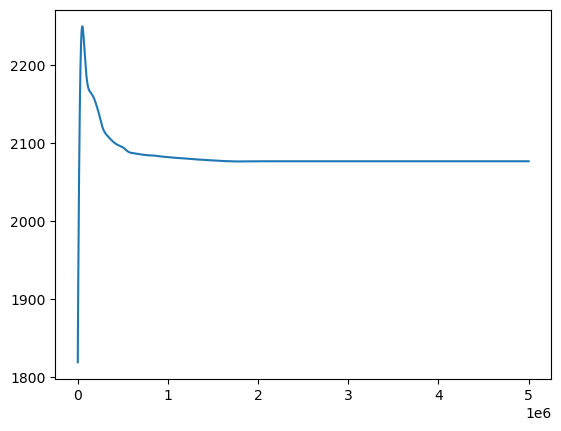

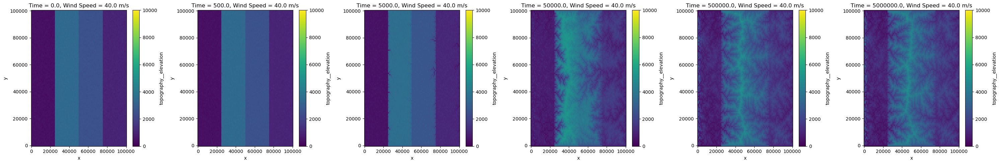

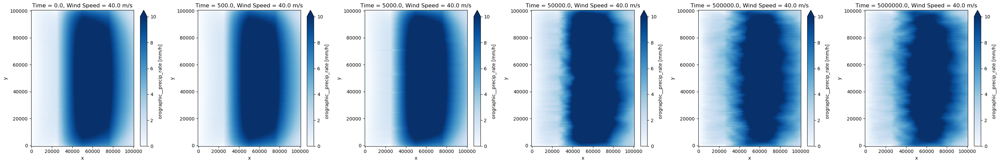

  - Mean elevation at final time: 2197.43 m
  - Max precipitation at final time: 12.98 mm/hr


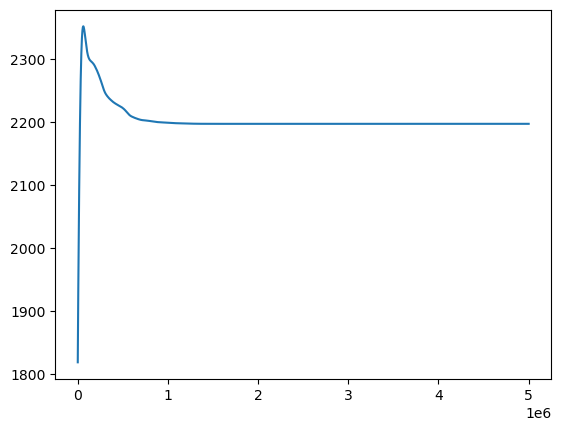

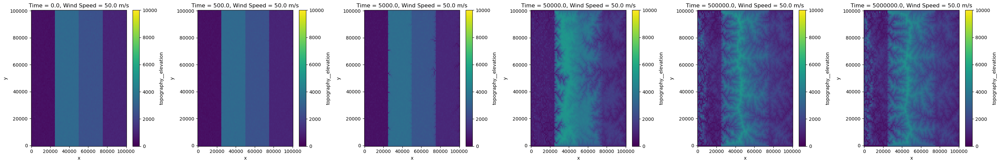

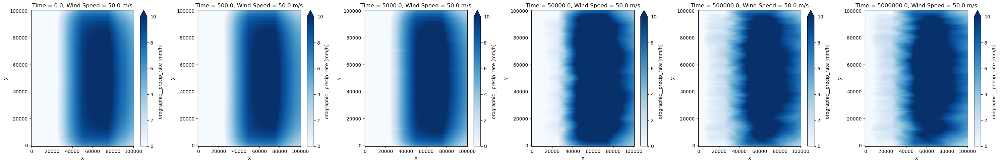

  - Mean elevation at final time: 2339.06 m
  - Max precipitation at final time: 12.21 mm/hr


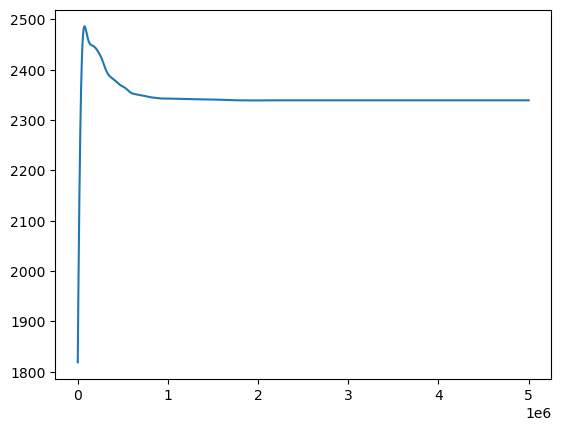

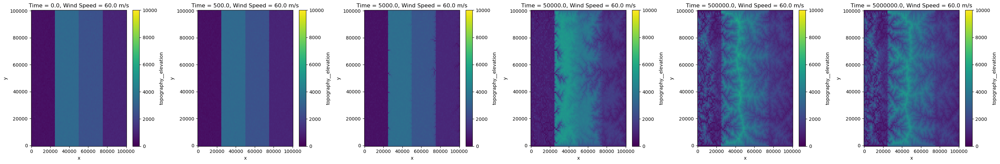

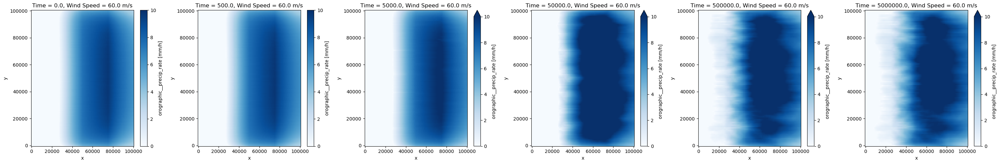

  - Mean elevation at final time: 2496.57 m
  - Max precipitation at final time: 11.56 mm/hr


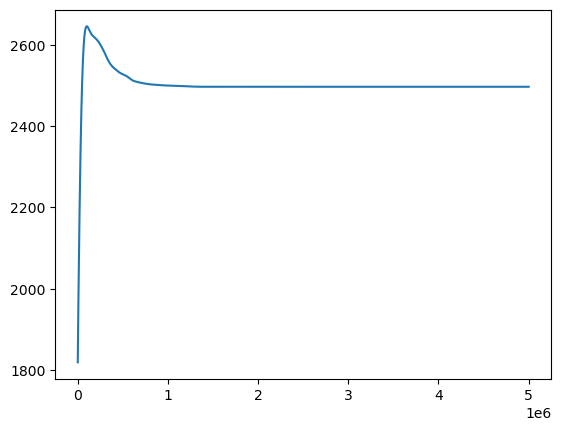

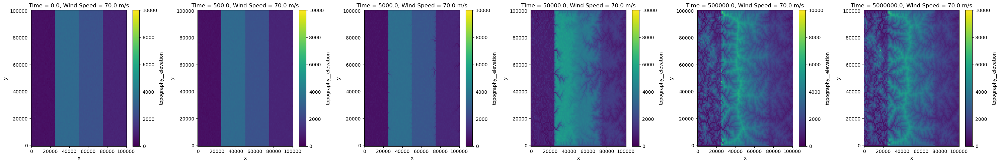

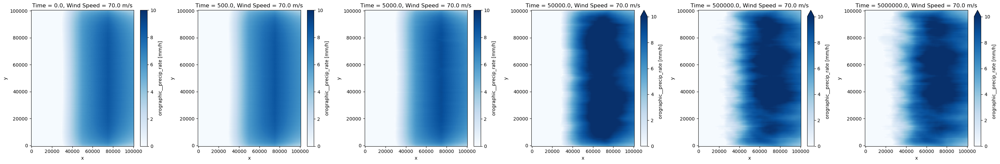

  - Mean elevation at final time: 2649.64 m
  - Max precipitation at final time: 10.72 mm/hr


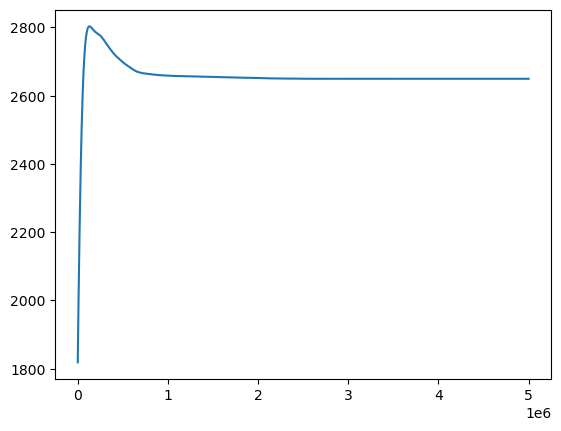

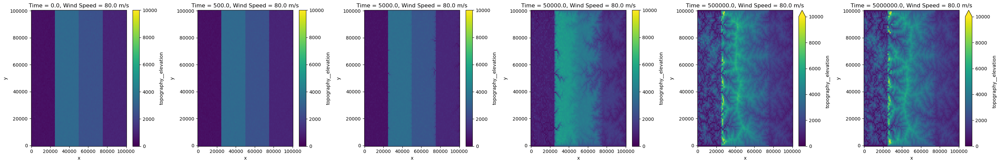

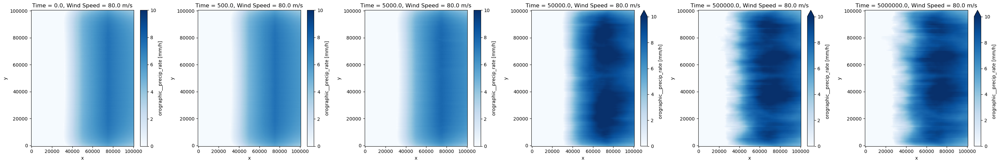

  - Mean elevation at final time: 2762.05 m
  - Max precipitation at final time: 10.04 mm/hr


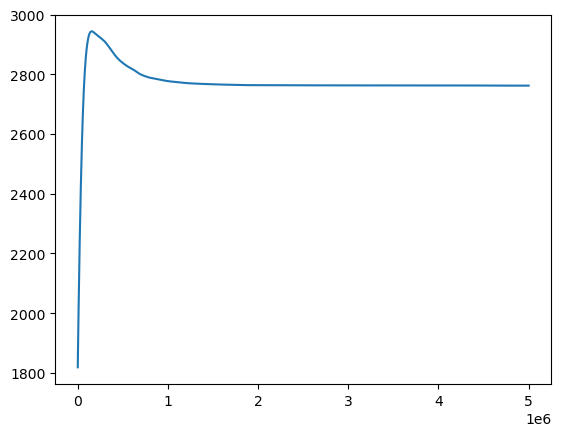

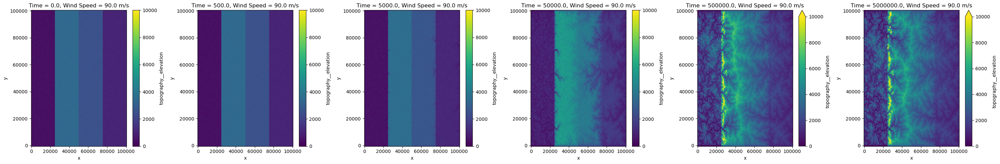

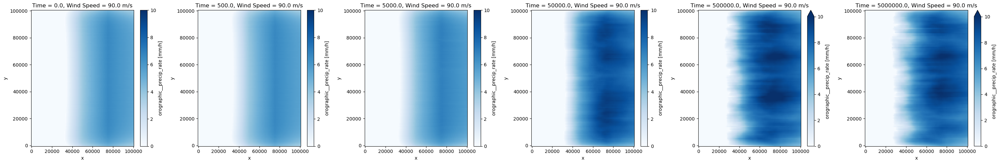

  - Mean elevation at final time: 2901.33 m
  - Max precipitation at final time: 9.61 mm/hr


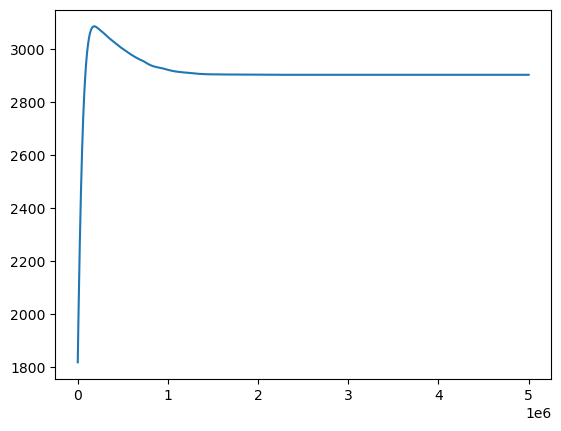

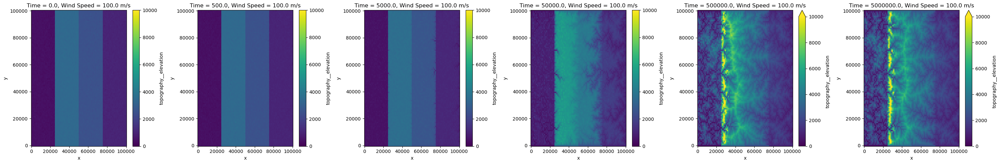

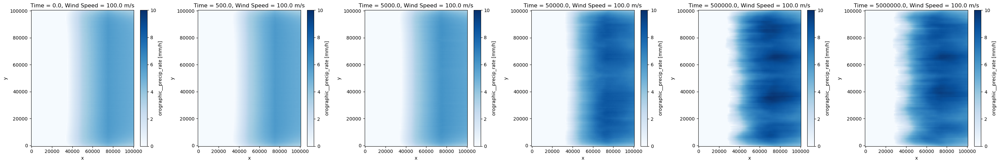

/var/folders/ws/0hr6lrzs09dcnvnzt4md1v900000gn/T/ipykernel_1038/604766670.py:71: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


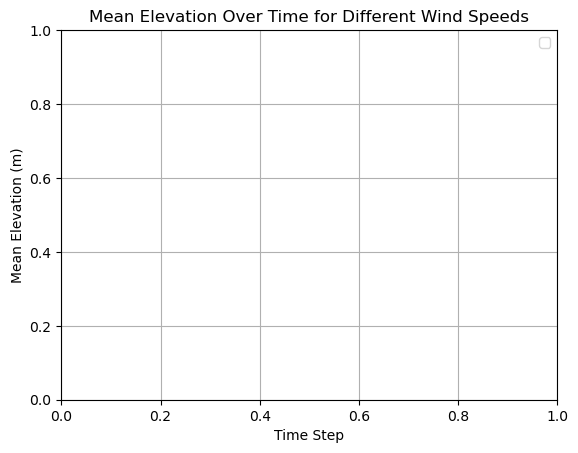

In [ ]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets
datasets = [xr.open_zarr(os.path.join(output_dir, f), chunks={}) for f in zarr_files]

# Time steps to visualize
time_indices = [0, 1, 10, 100, 1000, 10000]

# Function to plot elevation and precipitation maps
def plot_results(out_ds_winds, wind_speed):
    # Extract elevation and precipitation data at selected time indices
    elevation_data = out_ds_winds.topography__elevation.isel(time=time_indices)
    precip_data = out_ds_winds.orographic__precip_rate.isel(time=time_indices)

    # Print sample numerical outputs
    print(f"  - Mean elevation at final time: {elevation_data.isel(time=-1).mean().values:.2f} m")
    print(f"  - Max precipitation at final time: {precip_data.isel(time=-1).max().values:.2f} mm/hr")

    # Plot elevation over time
    fig, axes = plt.subplots(1, len(time_indices), figsize=(30, 5))
    for i, ax in enumerate(axes):
        elevation_data.isel(time=i).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
        ax.set_title(f"Time = {elevation_data.time[i].values}, Wind Speed = {wind_speed:.1f} m/s")
    plt.tight_layout()
    plt.savefig(f"Elevation_WindSpeed_{wind_speed:.2f}.png")
    plt.show()

    # Plot precipitation over time
    fig, axes = plt.subplots(1, len(time_indices), figsize=(30, 5))
    for i, ax in enumerate(axes):
        precip_data.isel(time=i).plot(ax=ax, vmin=0, vmax=10, cmap='Blues')
        ax.set_title(f"Time = {precip_data.time[i].values}, Wind Speed = {wind_speed:.1f} m/s")
    plt.tight_layout()
    plt.savefig(f"Precipitation_WindSpeed_{wind_speed:.2f}.png")
    plt.show()

# Initialize a figure for mean elevation over time
plt.figure(figsize=(10, 6))

# Loop through datasets and process each one
for ds, zarr_file in zip(datasets, zarr_files):
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    
    # Compute mean elevation at each time step
    mean_elevation = ds["topography__elevation"].mean(dim=("x", "y"))
    
    # Extract time values
    time_steps = ds["time"].values

    # Plot mean elevation over time
    plt.plot(time_steps, mean_elevation, label=f"Wind {wind_speed:.1f} m/s")
    
    # Call function to plot elevation and precipitation maps
    plot_results(ds, wind_speed)

# Customize mean elevation plot
plt.xlabel("Time Step")
plt.ylabel("Mean Elevation (m)")
plt.title("Mean Elevation Over Time for Different Wind Speeds")
plt.legend()
plt.grid()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


  - Mean elevation at final time: 9805.45 m
  - Max precipitation at final time: 26.07 mm/hr


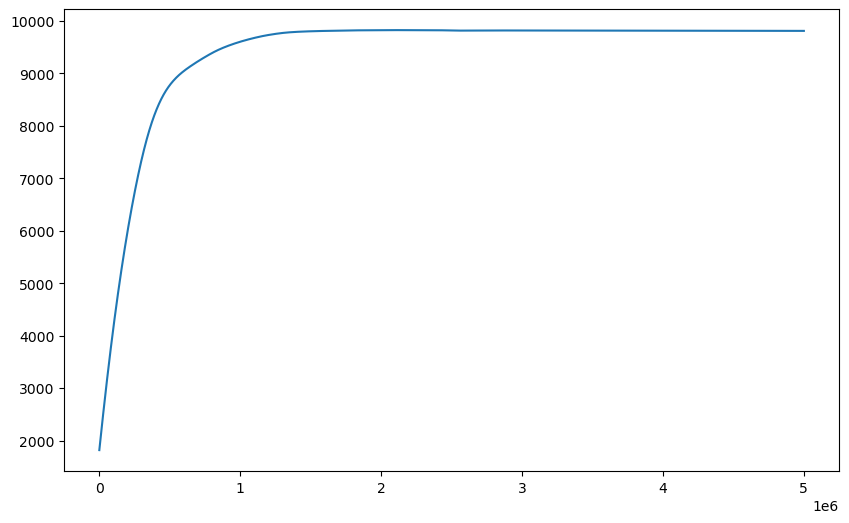

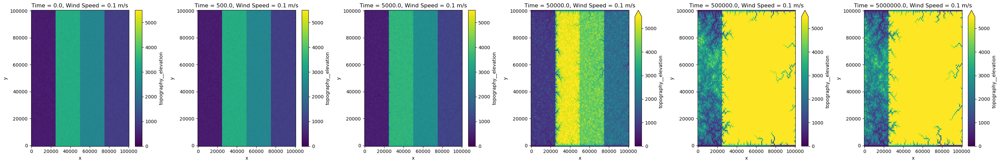

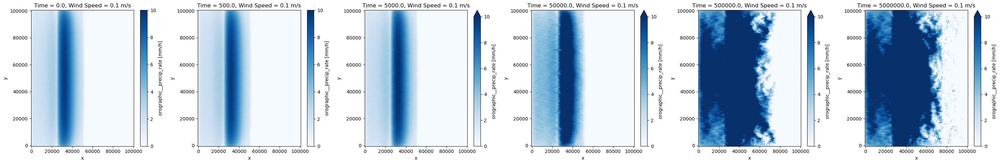

  - Mean elevation at final time: 3815.63 m
  - Max precipitation at final time: 9.60 mm/hr


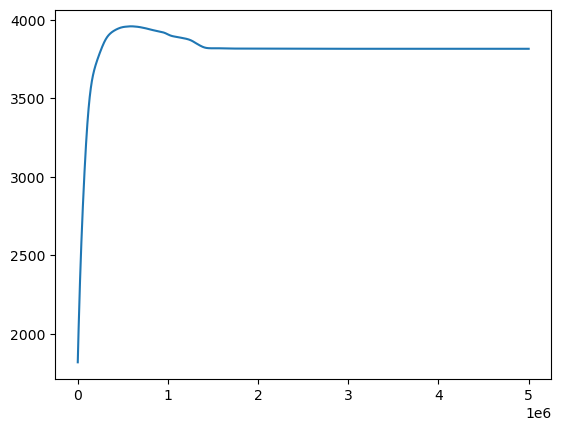

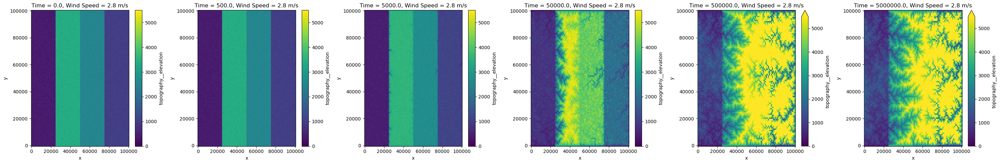

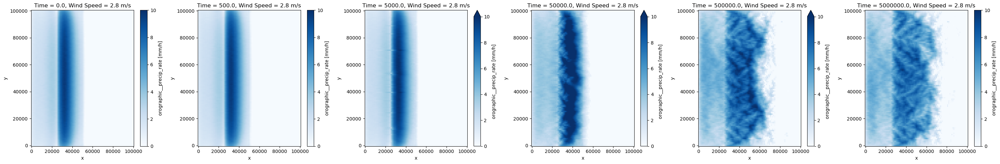

  - Mean elevation at final time: 3188.39 m
  - Max precipitation at final time: 7.90 mm/hr


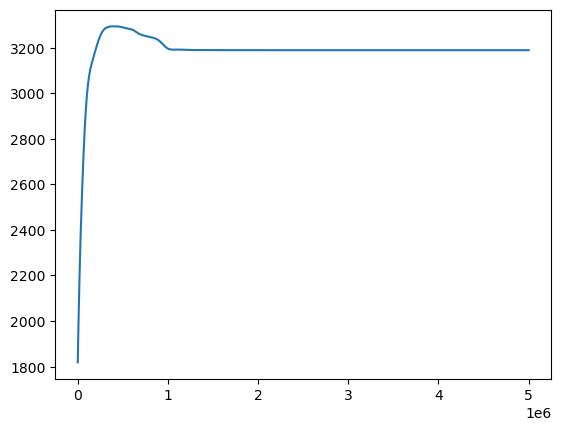

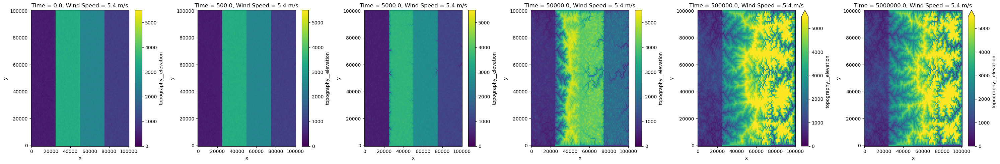

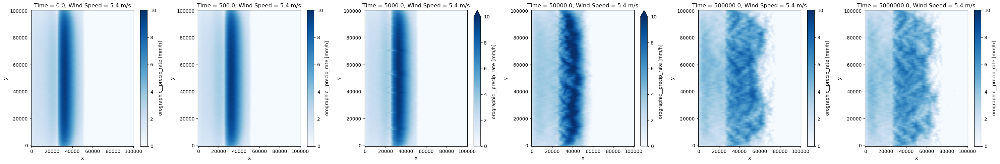

  - Mean elevation at final time: 2869.25 m
  - Max precipitation at final time: 6.98 mm/hr


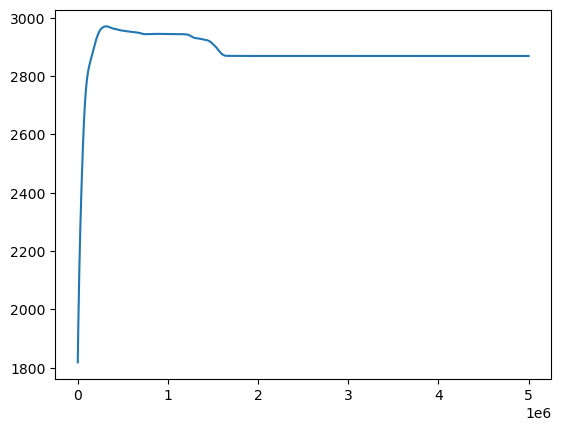

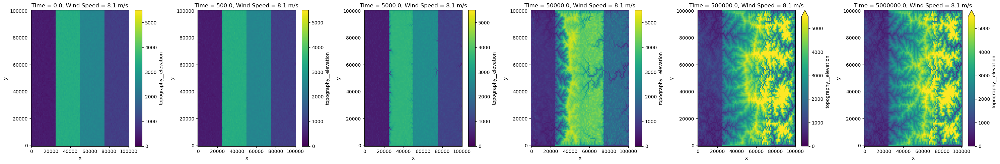

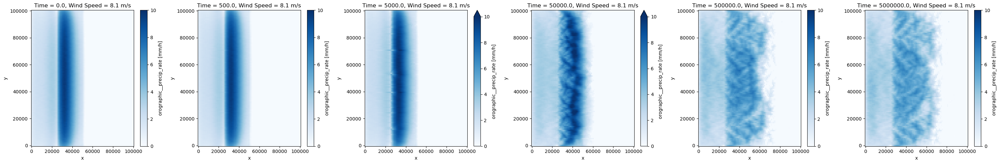

  - Mean elevation at final time: 3249.57 m
  - Max precipitation at final time: 8.16 mm/hr


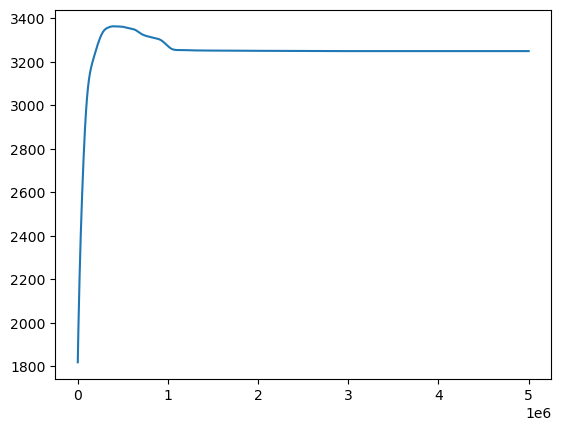

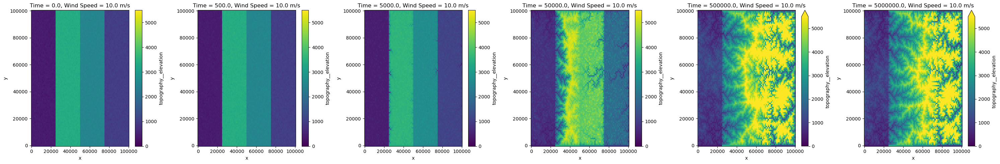

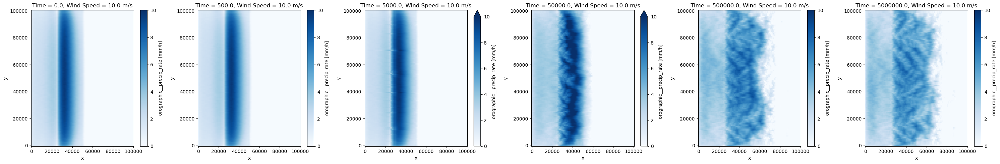

  - Mean elevation at final time: 2321.67 m
  - Max precipitation at final time: 13.48 mm/hr


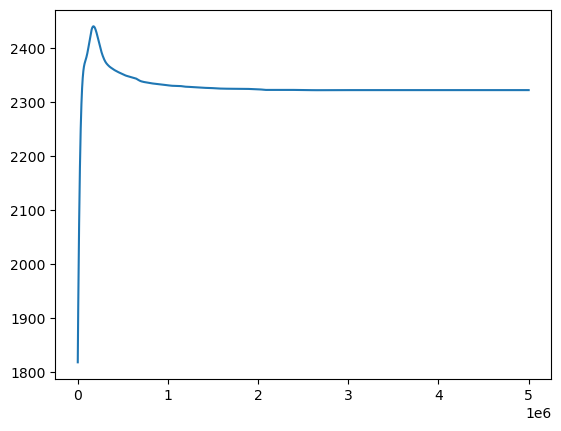

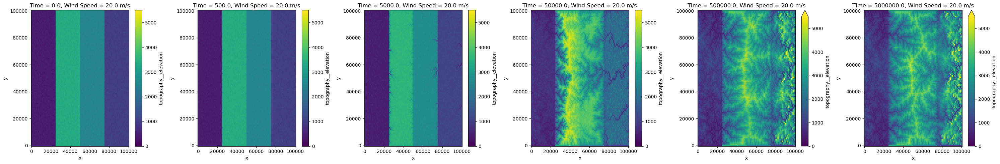

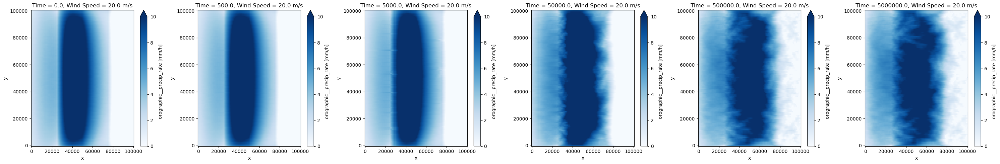

  - Mean elevation at final time: 2043.31 m
  - Max precipitation at final time: 14.61 mm/hr


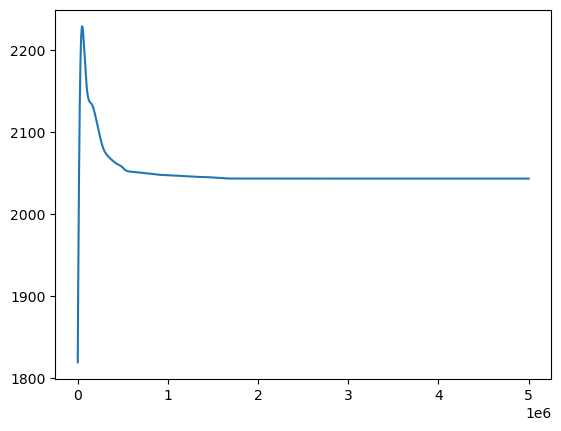

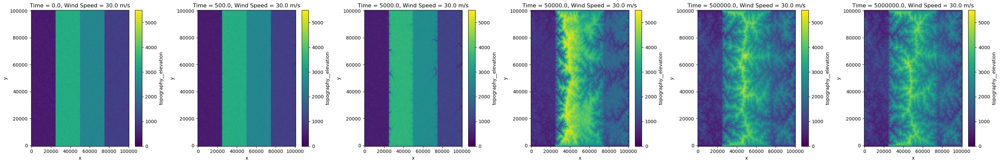

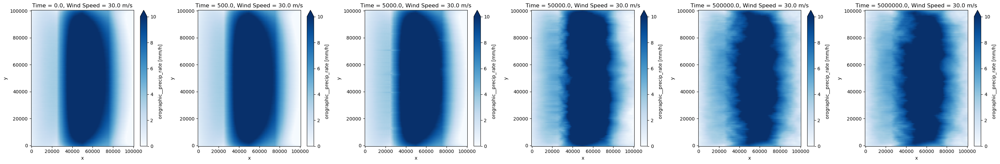

  - Mean elevation at final time: 2076.63 m
  - Max precipitation at final time: 14.06 mm/hr


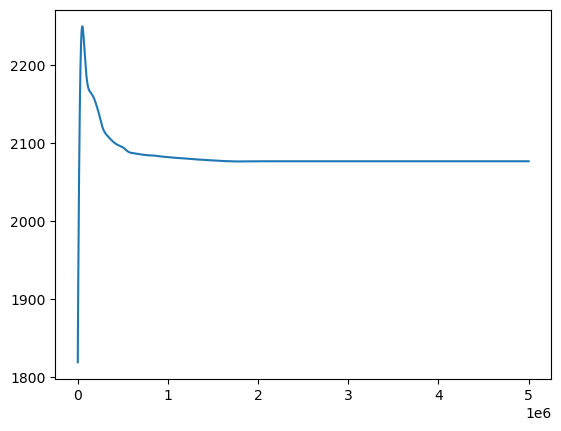

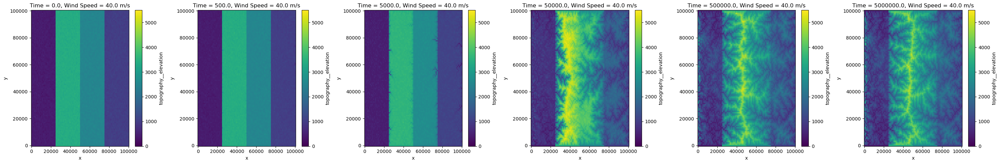

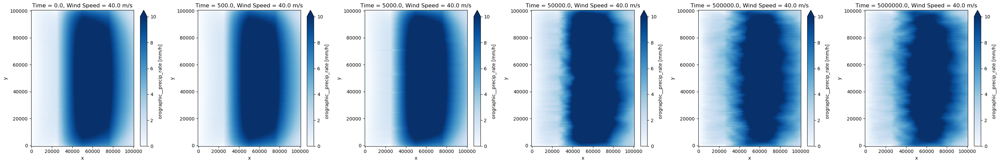

  - Mean elevation at final time: 2197.43 m
  - Max precipitation at final time: 12.98 mm/hr


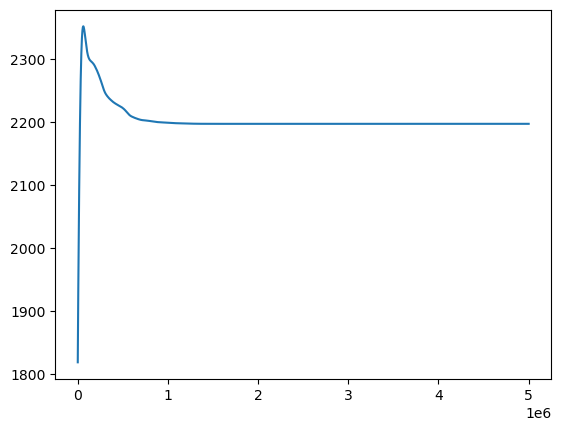

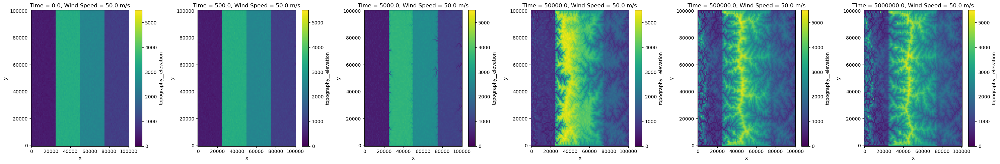

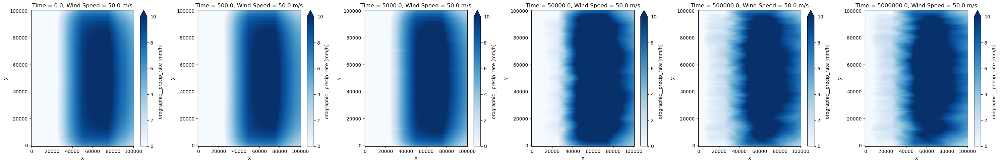

  - Mean elevation at final time: 2339.06 m
  - Max precipitation at final time: 12.21 mm/hr


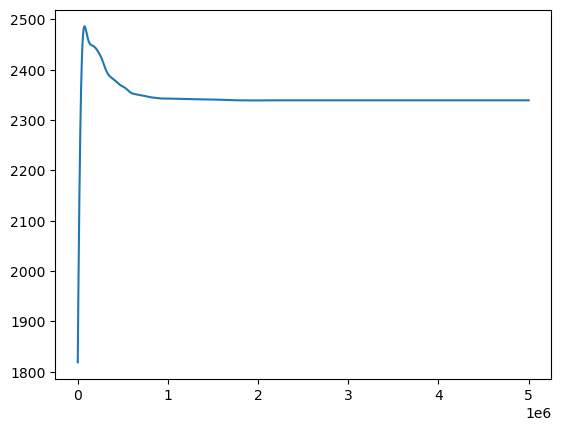

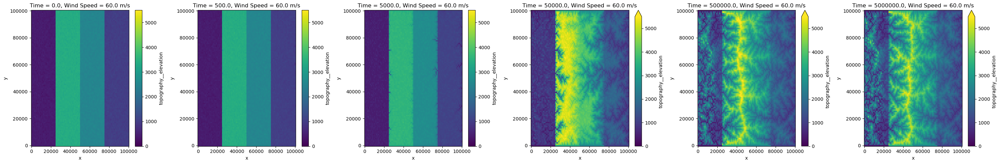

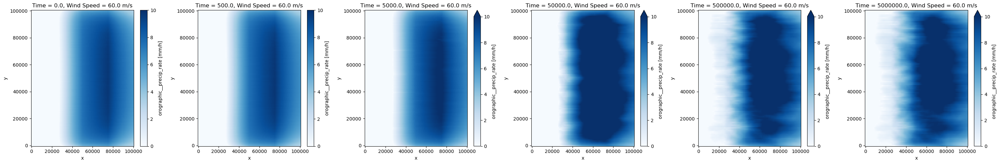

  - Mean elevation at final time: 2496.57 m
  - Max precipitation at final time: 11.56 mm/hr


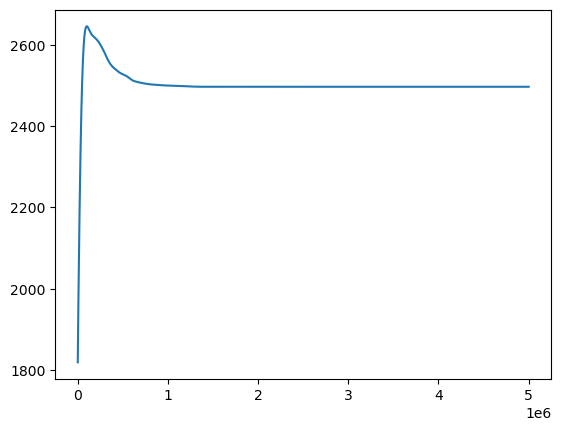

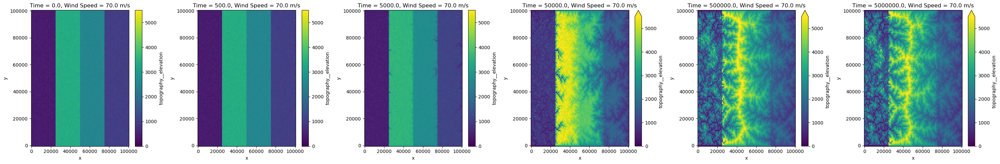

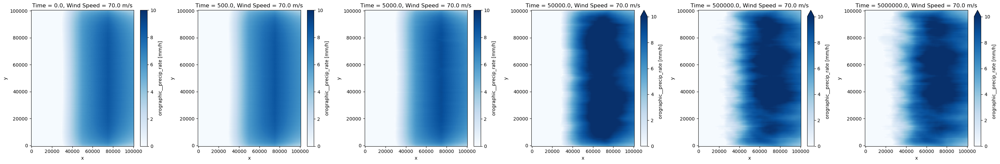

  - Mean elevation at final time: 2649.64 m
  - Max precipitation at final time: 10.72 mm/hr


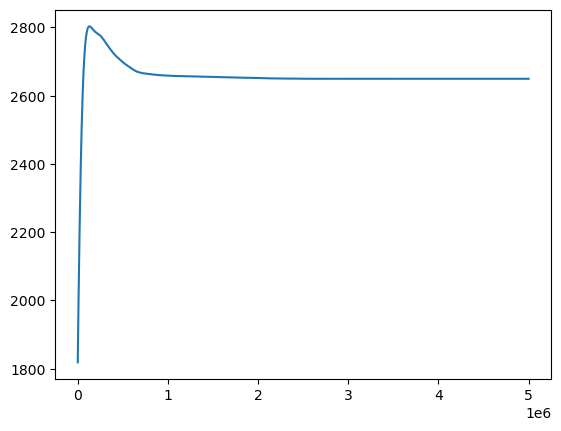

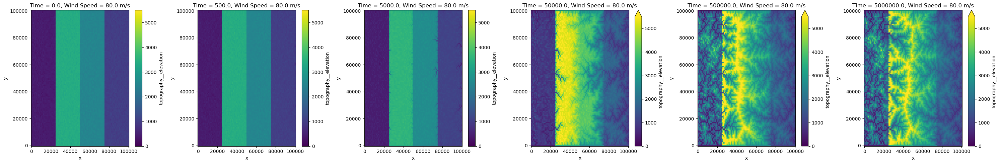

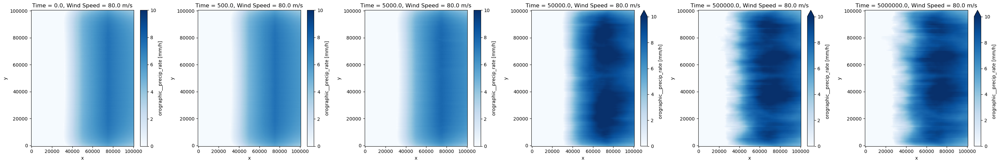

  - Mean elevation at final time: 2762.05 m
  - Max precipitation at final time: 10.04 mm/hr


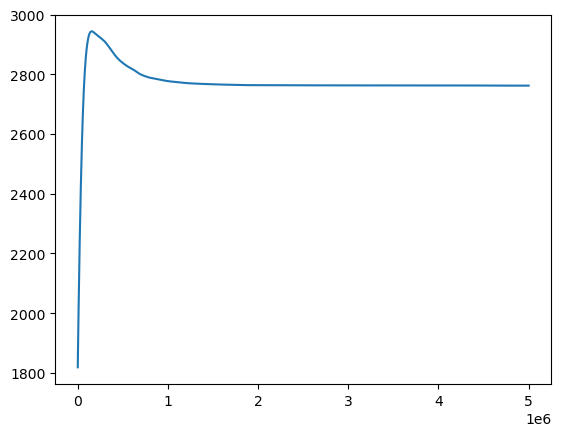

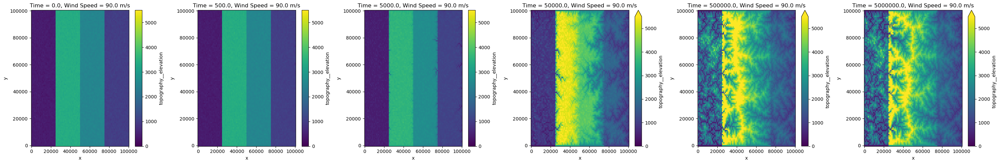

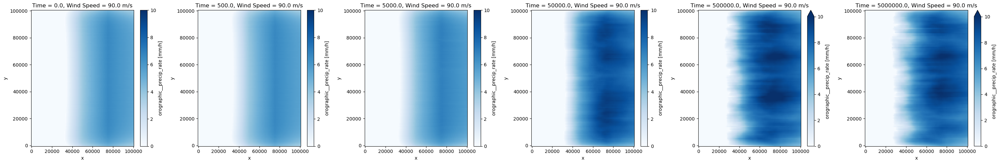

  - Mean elevation at final time: 2901.33 m
  - Max precipitation at final time: 9.61 mm/hr


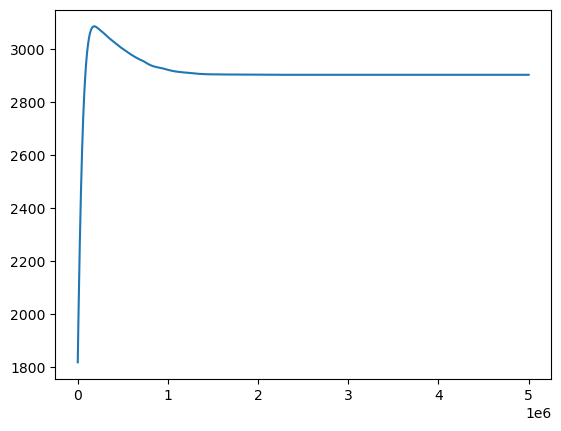

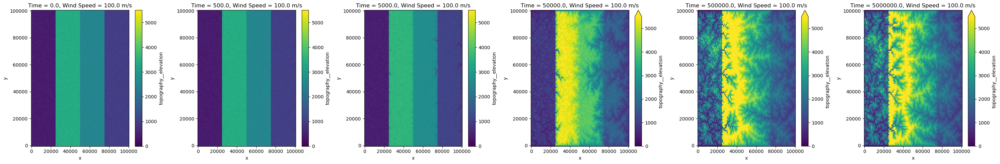

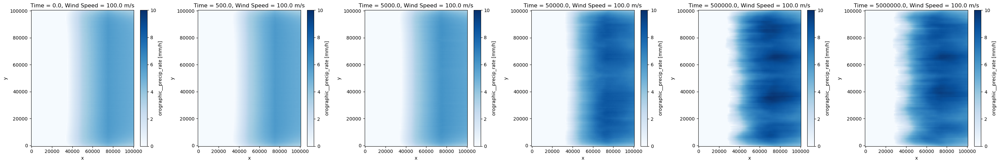

/var/folders/ws/0hr6lrzs09dcnvnzt4md1v900000gn/T/ipykernel_1038/1785287902.py:72: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


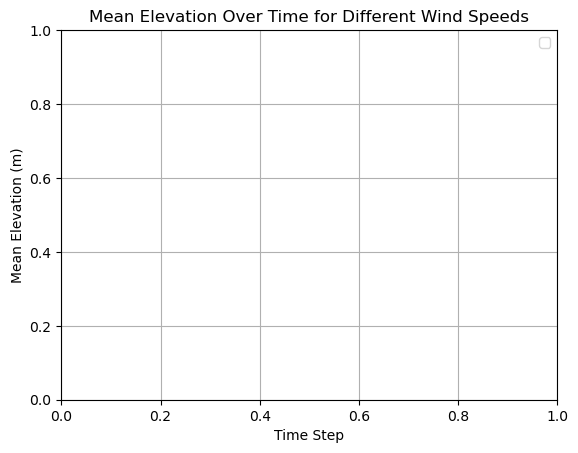

ValueError: The supplied groupby dimension(s) ['wind_speed'] could not be found, expected one or more of: ['time', 'x', 'y']

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets
datasets = [xr.open_zarr(os.path.join(output_dir, f), chunks={}) for f in zarr_files]

# Time steps to visualize
time_indices = [0, 1, 10, 100, 1000, 10000]

# Function to plot elevation and precipitation maps
def plot_results(out_ds_winds, wind_speed):
    # Extract elevation and precipitation data at selected time indices
    elevation_data = out_ds_winds.topography__elevation.isel(time=time_indices)
    precip_data = out_ds_winds.orographic__precip_rate.isel(time=time_indices)

    # Print sample numerical outputs
    print(f"  - Mean elevation at final time: {elevation_data.isel(time=-1).mean().values:.2f} m")
    print(f"  - Max precipitation at final time: {precip_data.isel(time=-1).max().values:.2f} mm/hr")

    # Plot elevation over time
    fig, axes = plt.subplots(1, len(time_indices), figsize=(30, 5))
    for i, ax in enumerate(axes):
        elevation_data.isel(time=i).plot(ax=ax, vmin=0, vmax=5500, cmap='viridis')
        ax.set_title(f"Time = {elevation_data.time[i].values}, Wind Speed = {wind_speed:.1f} m/s")
    plt.tight_layout()
    plt.savefig(f"Elevation_WindSpeed_{wind_speed:.2f}.png")
    plt.show()

    # Plot precipitation over time
    fig, axes = plt.subplots(1, len(time_indices), figsize=(30, 5))
    for i, ax in enumerate(axes):
        precip_data.isel(time=i).plot(ax=ax, vmin=0, vmax=10, cmap='Blues')
        ax.set_title(f"Time = {precip_data.time[i].values}, Wind Speed = {wind_speed:.1f} m/s")
    plt.tight_layout()
    plt.savefig(f"Precipitation_WindSpeed_{wind_speed:.2f}.png")
    plt.show()

# Initialize a figure for mean elevation over time
plt.figure(figsize=(10, 6))

# Loop through datasets and process each one
for ds, zarr_file in zip(datasets, zarr_files):
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    
    # Compute mean elevation at each time step
    mean_elevation = ds["topography__elevation"].mean(dim=("x", "y"))
    
    # Extract time values
    time_steps = ds["time"].values

    # Plot mean elevation over time
    plt.plot(time_steps, mean_elevation, label=f"Wind {wind_speed:.1f} m/s")
    
    # Call function to plot elevation and precipitation maps
    plot_results(ds, wind_speed)

# Customize mean elevation plot
plt.xlabel("Time Step")
plt.ylabel("Mean Elevation (m)")
plt.title("Mean Elevation Over Time for Different Wind Speeds")
plt.legend()
plt.grid()
plt.show()

# ---- HVPlot Interactive Visualization ---- #
# Combine all datasets into a single xarray dataset
combined_ds = xr.concat(datasets, dim="wind_speed")

# Interactive elevation map
elevation_plot = combined_ds.topography__elevation.hvplot.image(
    x='x', y='y', cmap='viridis', groupby=['wind_speed', 'time']
)
elevation_plot

# Compute and plot mean elevation over wind speed
avg_elevation = combined_ds.topography__elevation.mean(dim='wind_speed')

# Plot elevation profile along x=10000
avg_elevation.isel(time=-1).sel(x=10000).plot()

# Plot mean elevation at the last time step across different wind speeds
(combined_ds
 .topography__elevation.isel(time=-1)  # Select last time step
 .mean(dim='x')  # Average over 'x' axis
 .plot(col='wind_speed', col_wrap=4)  # Plot for each wind speed
)

# Close all datasets
for ds in datasets:
    ds.close()


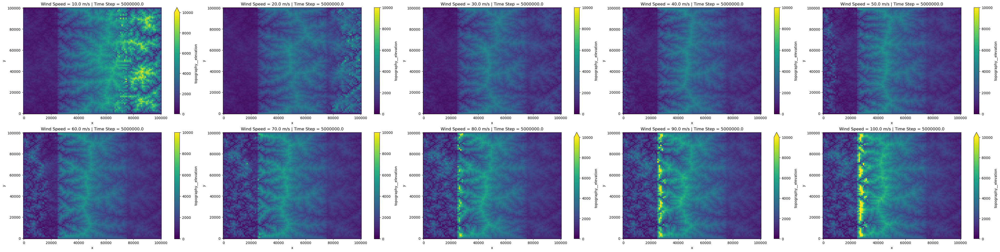

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Define the specific wind speeds to plot
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
time_steps = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    if wind_speed in desired_wind_speeds:  # Only include the desired wind speeds
        ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
        
        # Add wind_speed as a coordinate
        ds = ds.assign_coords(wind_speed=wind_speed)
        
        datasets.append(ds)
        wind_speeds.append(wind_speed)  # Append only desired wind speeds
        
        # Extract the time step (assuming 'time' is a coordinate)
        time_steps.append(ds.time.values[-1])  # Get the last time step value

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Calculate the number of rows and columns based on the number of wind speeds
num_plots = len(wind_speeds)
num_cols = (num_plots + 1) // 2  # Number of columns (2 per row)
num_rows = (num_plots + num_cols - 1) // num_cols  # Ensure we cover all plots

# 📌 Plot: Elevation Maps for Selected Wind Speeds at Final Time Step
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(40, 10), constrained_layout=True)  # Increased width
axes = axes.flatten()

# Loop over datasets and create plots
for ax, ds, wind_speed, time_step in zip(axes, datasets, wind_speeds, time_steps):
    ds.topography__elevation.isel(time=-1).plot(ax=ax, vmin=0, vmax=10000, cmap='viridis')
    ax.set_title(f"Wind Speed = {wind_speed:.1f} m/s | Time Step = {time_step}", fontsize=12)
    ax.set_xlabel("x")
    ax.set_ylabel("y")

# Hide any unused subplots
for i in range(len(wind_speeds), len(axes)):
    fig.delaxes(axes[i])

plt.savefig("Elevation_WindSpeed_Selected.png")
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


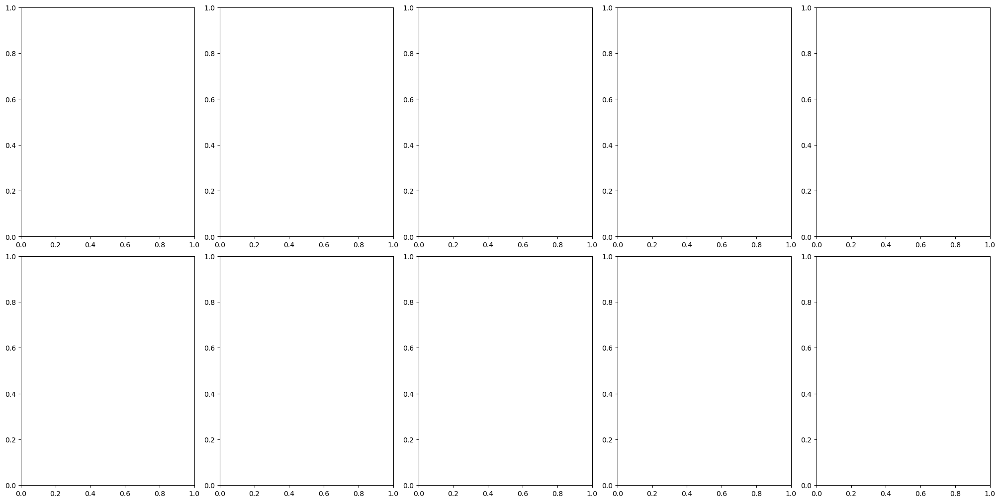

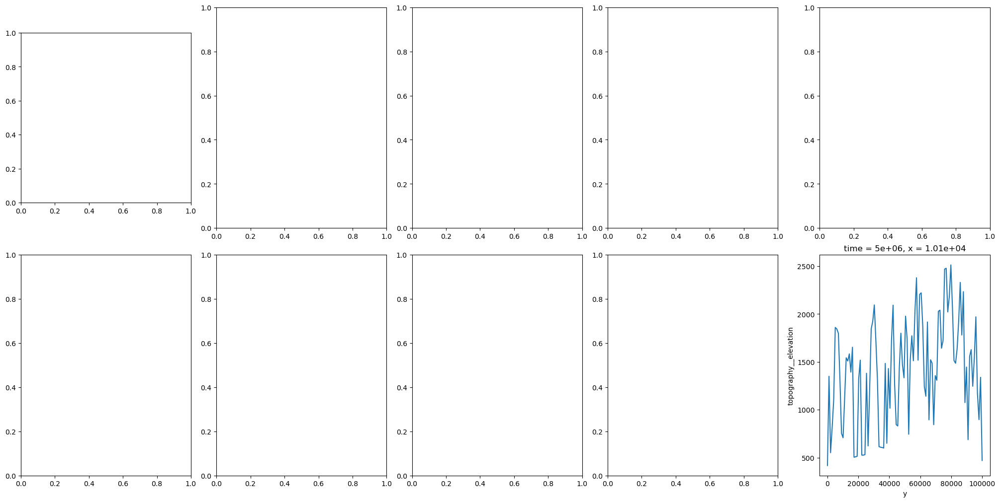

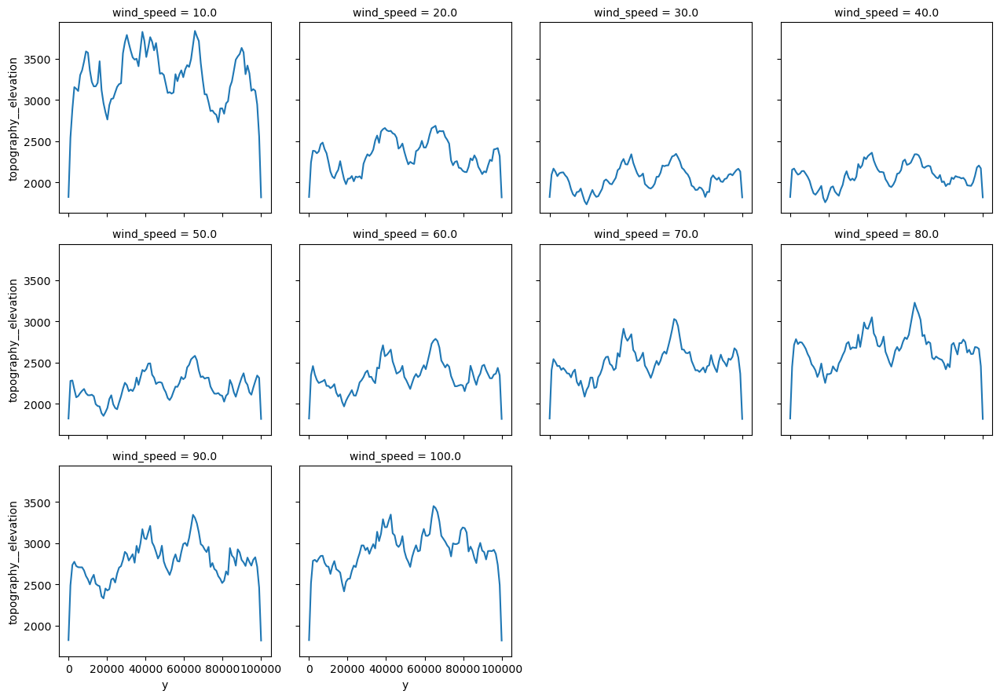

In [43]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Interactive elevation map
elevation_plot = combined_ds.topography__elevation.hvplot.image(
    x='x', y='y', cmap='viridis', groupby=['time', 'wind_speed']
)
elevation_plot

# Compute and plot mean elevation over wind speed
avg_elevation = combined_ds.topography__elevation.mean(dim='wind_speed')

# Fix: Use method="nearest" to avoid KeyError
avg_elevation.isel(time=-1).sel(x=10000, method="nearest").plot()

# Plot mean elevation at the last time step across different wind speeds
(combined_ds
 .topography__elevation.isel(time=-1)  # Select last time step
 .mean(dim='x')  # Average over 'x' axis
 .plot(col='wind_speed', col_wrap=4)  # Plot for each wind speed
)

# Ensure the plots are displayed
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


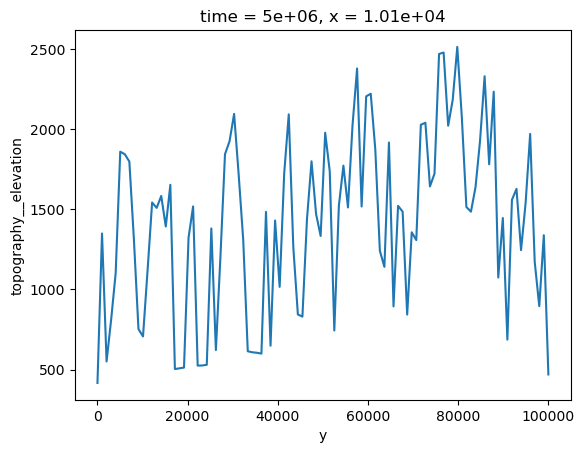

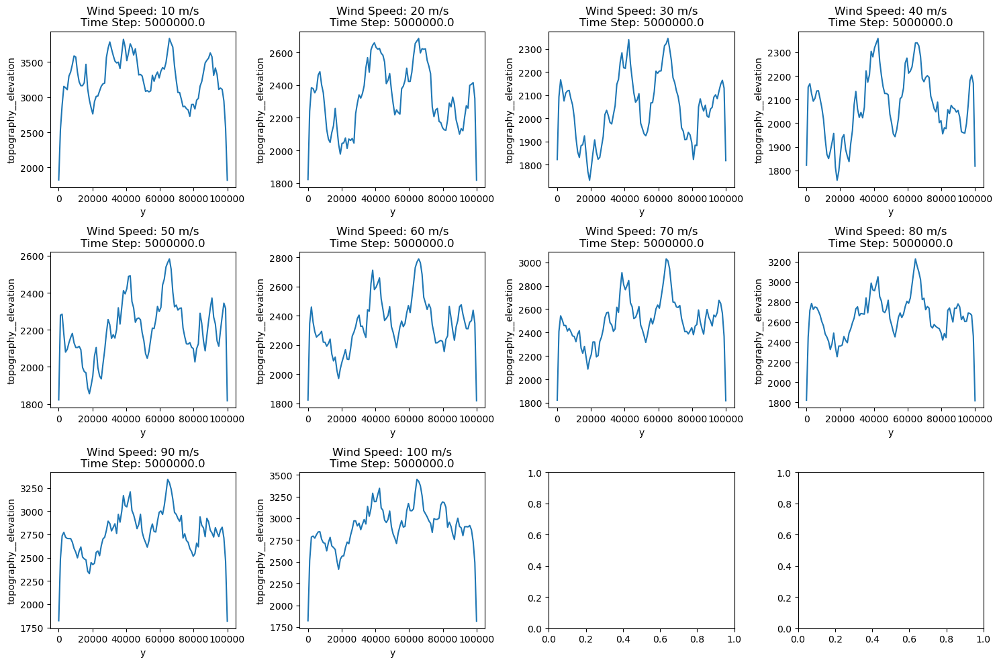

In [44]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Interactive elevation map
elevation_plot = combined_ds.topography__elevation.hvplot.image(
    x='x', y='y', cmap='viridis', groupby=['time', 'wind_speed']
)
elevation_plot

# Compute and plot mean elevation over wind speed
avg_elevation = combined_ds.topography__elevation.mean(dim='wind_speed')

# Fix: Use method="nearest" to avoid KeyError
avg_elevation.isel(time=-1).sel(x=10000, method="nearest").plot()

# Plot mean elevation at the last time step across different wind speeds
# Add time step information in the title
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15, 10))  # Adjust grid size as needed
for idx, wind_speed in enumerate(desired_wind_speeds):
    ax = axes[idx // 4, idx % 4]  # Get the appropriate subplot axis
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Plot mean elevation for this wind speed at the last time step
    (combined_ds
     .topography__elevation.isel(time=-1)  # Select last time step
     .sel(wind_speed=wind_speed)  # Select current wind speed
     .mean(dim='x')  # Average over 'x' axis
     .plot(ax=ax)  # Plot on the current axis
    )
    ax.set_title(title)  # Set the title with wind speed and time step information

# Ensure the plots are displayed
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


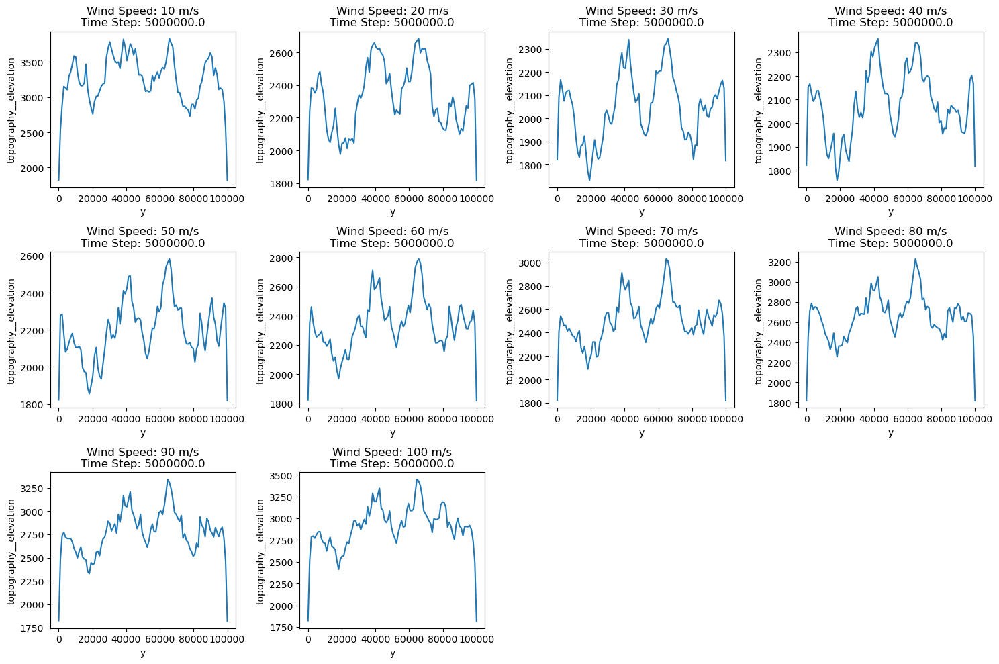

In [45]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Adjust number of rows and columns based on valid wind speeds
n_valid = len(valid_wind_speeds)
ncols = 4  # Define the number of columns
nrows = (n_valid // ncols) + (1 if n_valid % ncols != 0 else 0)  # Calculate rows needed

# Create subplots dynamically based on valid wind speeds
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Flatten axes to make indexing easier if there are multiple rows and columns
axes = axes.flatten()

# Plot only for valid wind speeds
for idx, wind_speed in enumerate(valid_wind_speeds):
    ax = axes[idx]
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Plot mean elevation for this wind speed at the last time step
    (combined_ds
     .topography__elevation.isel(time=-1)  # Select last time step
     .sel(wind_speed=wind_speed)  # Select current wind speed
     .mean(dim='x')  # Average over 'x' axis
     .plot(ax=ax)  # Plot on the current axis
    )
    ax.set_title(title)  # Set the title with wind speed and time step information

# Hide unused axes
for ax in axes[len(valid_wind_speeds):]:
    ax.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


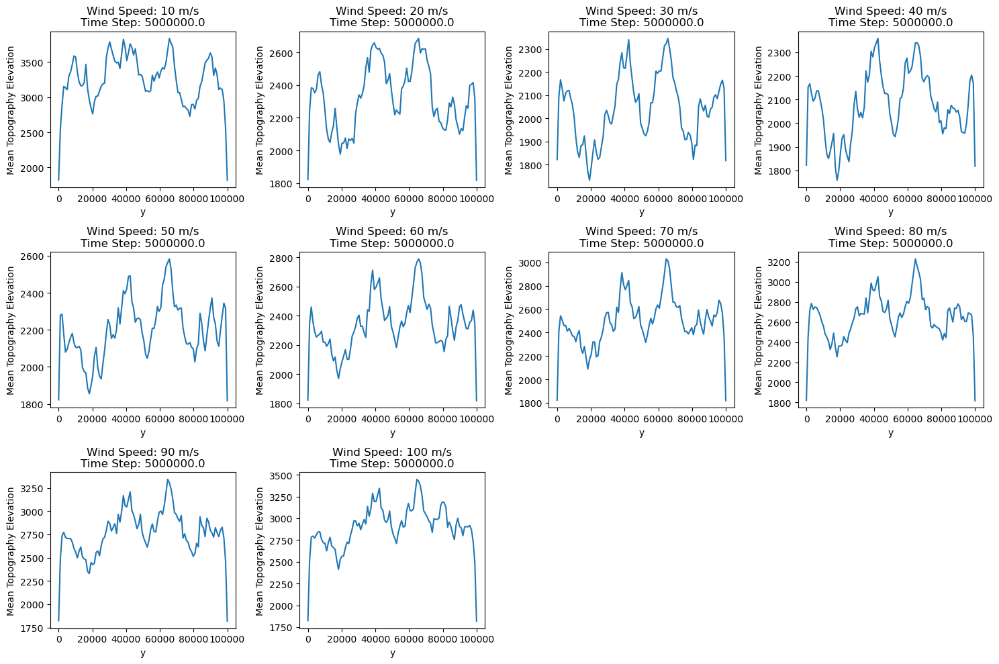

In [46]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Adjust number of rows and columns based on valid wind speeds
n_valid = len(valid_wind_speeds)
ncols = 4  # Define the number of columns
nrows = (n_valid // ncols) + (1 if n_valid % ncols != 0 else 0)  # Calculate rows needed

# Create subplots dynamically based on valid wind speeds
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Flatten axes to make indexing easier if there are multiple rows and columns
axes = axes.flatten()

# Plot only for valid wind speeds
for idx, wind_speed in enumerate(valid_wind_speeds):
    ax = axes[idx]
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Plot mean elevation for this wind speed at the last time step
    (combined_ds
     .topography__elevation.isel(time=-1)  # Select last time step
     .sel(wind_speed=wind_speed)  # Select current wind speed
     .mean(dim='x')  # Average over 'x' axis
     .plot(ax=ax)  # Plot on the current axis
    )
    ax.set_title(title)  # Set the title with wind speed and time step information
    ax.set_ylabel("Mean Topography Elevation")  # Set y-axis label

# Hide unused axes
for ax in axes[len(valid_wind_speeds):]:
    ax.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


In [47]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Adjust number of rows and columns based on valid wind speeds
n_valid = len(valid_wind_speeds)
ncols = 4  # Define the number of columns
nrows = (n_valid // ncols) + (1 if n_valid % ncols != 0 else 0)  # Calculate rows needed

# Create subplots dynamically based on valid wind speeds
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Flatten axes to make indexing easier if there are multiple rows and columns
axes = axes.flatten()

# Determine the global min and max for consistent color scale
all_mean_elevations = [
    combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    for wind_speed in valid_wind_speeds
]
min_elevation = np.min([elevation.min() for elevation in all_mean_elevations])
max_elevation = np.max([elevation.max() for elevation in all_mean_elevations])

# Plot only for valid wind speeds
for idx, wind_speed in enumerate(valid_wind_speeds):
    ax = axes[idx]
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Plot mean elevation for this wind speed at the last time step with consistent color scale
    (combined_ds
     .topography__elevation.isel(time=-1)  # Select last time step
     .sel(wind_speed=wind_speed)  # Select current wind speed
     .mean(dim='x')  # Average over 'x' axis
     .plot(ax=ax, vmin=min_elevation, vmax=max_elevation)  # Apply consistent color scale
    )
    ax.set_title(title)  # Set the title with wind speed and time step information
    ax.set_ylabel("Mean Topography Elevation")  # Set y-axis label

# Hide unused axes
for ax in axes[len(valid_wind_speeds):]:
    ax.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


AttributeError: Line2D.set() got an unexpected keyword argument 'vmin'

In [48]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Adjust number of rows and columns based on valid wind speeds
n_valid = len(valid_wind_speeds)
ncols = 4  # Define the number of columns
nrows = (n_valid // ncols) + (1 if n_valid % ncols != 0 else 0)  # Calculate rows needed

# Create subplots dynamically based on valid wind speeds
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Flatten axes to make indexing easier if there are multiple rows and columns
axes = axes.flatten()

# Determine the global min and max for consistent color scale
all_mean_elevations = [
    combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    for wind_speed in valid_wind_speeds
]
min_elevation = np.min([elevation.min() for elevation in all_mean_elevations])
max_elevation = np.max([elevation.max() for elevation in all_mean_elevations])

# Plot only for valid wind speeds
for idx, wind_speed in enumerate(valid_wind_speeds):
    ax = axes[idx]
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Get the mean elevation for this wind speed at the last time step
    elevation_data = combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    
    # Use imshow to plot the data with consistent color scale
    c = ax.imshow(elevation_data, cmap='viridis', vmin=min_elevation, vmax=max_elevation, origin='lower')
    
    ax.set_title(title)  # Set the title with wind speed and time step information
    ax.set_ylabel("Mean Topography Elevation")  # Set y-axis label
    
    # Add colorbar for each plot
    fig.colorbar(c, ax=ax, orientation='vertical')

# Hide unused axes
for ax in axes[len(valid_wind_speeds):]:
    ax.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


TypeError: Invalid shape (100,) for image data

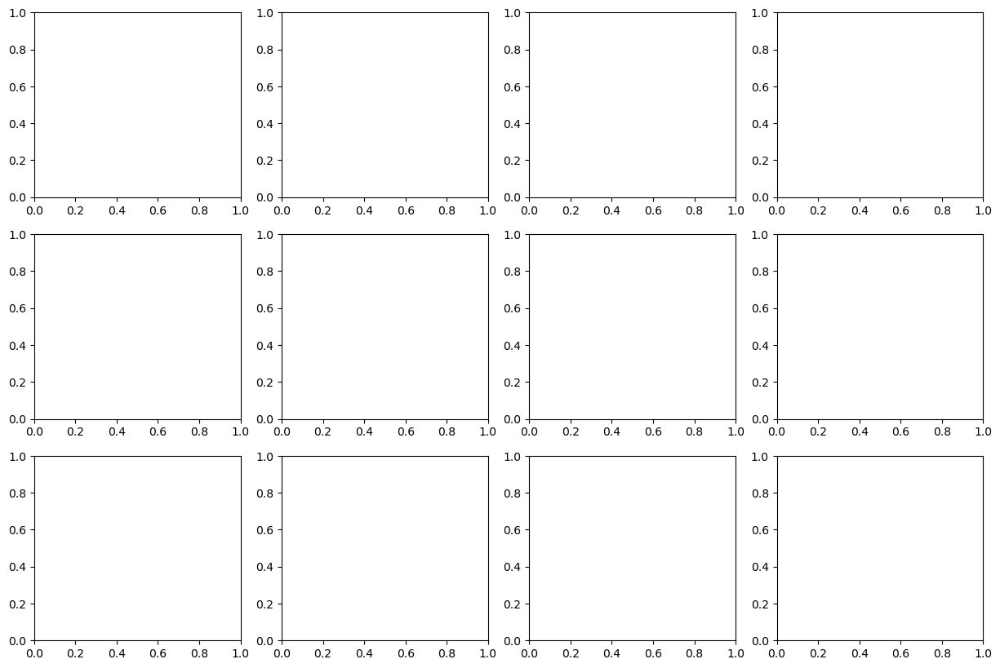

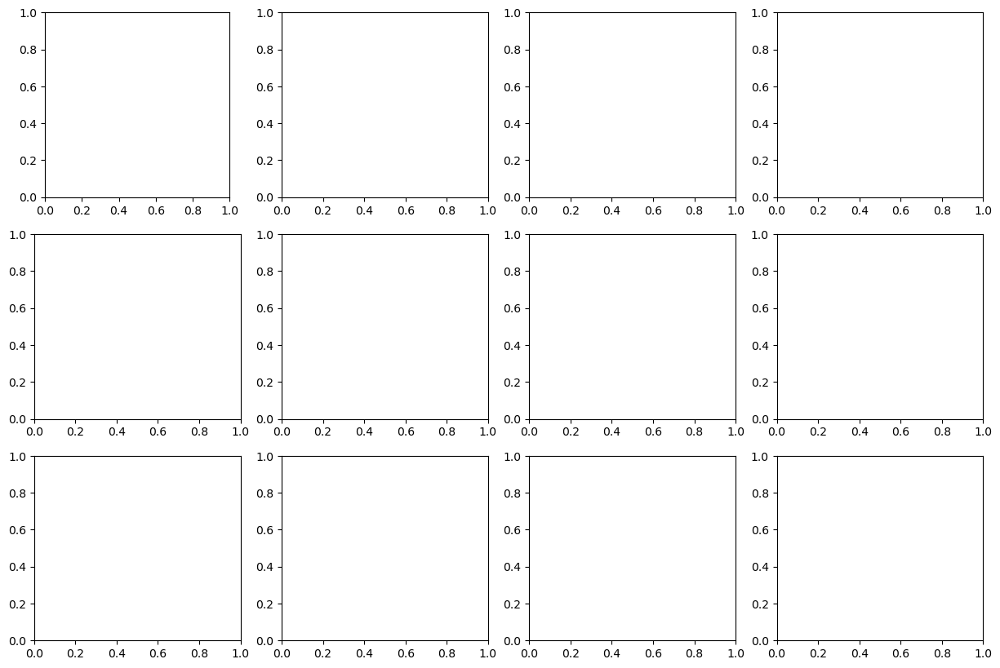

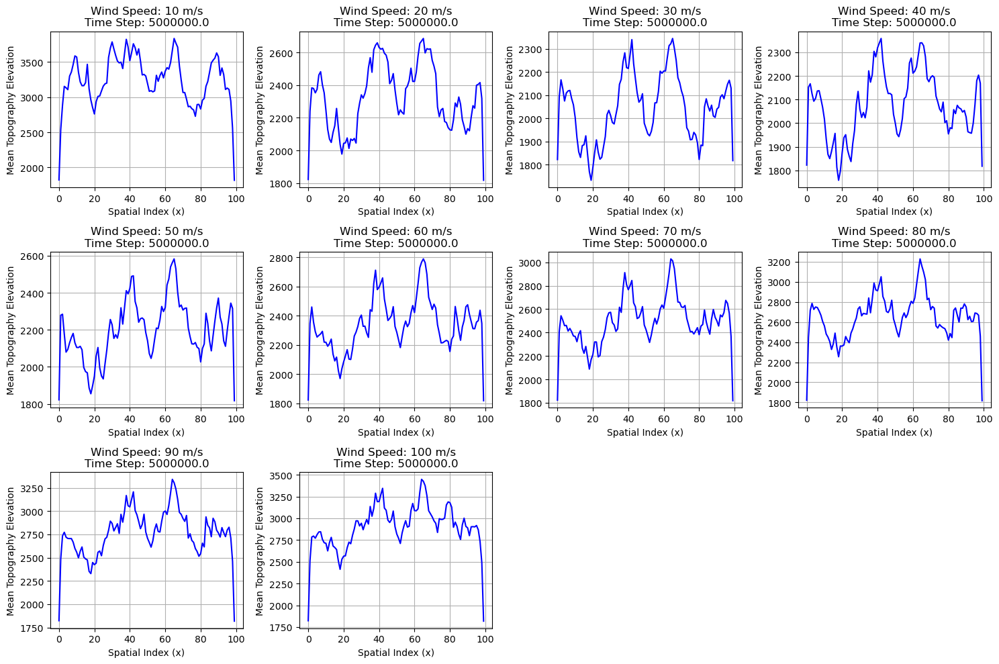

In [49]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Adjust number of rows and columns based on valid wind speeds
n_valid = len(valid_wind_speeds)
ncols = 4  # Define the number of columns
nrows = (n_valid // ncols) + (1 if n_valid % ncols != 0 else 0)  # Calculate rows needed

# Create subplots dynamically based on valid wind speeds
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Flatten axes to make indexing easier if there are multiple rows and columns
axes = axes.flatten()

# Plot only for valid wind speeds
for idx, wind_speed in enumerate(valid_wind_speeds):
    ax = axes[idx]
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Get the mean elevation for this wind speed at the last time step
    elevation_data = combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    
    # Plot the elevation data as a line plot
    ax.plot(elevation_data, label='Mean Topography Elevation', color='blue')
    
    ax.set_title(title)  # Set the title with wind speed and time step information
    ax.set_ylabel("Mean Topography Elevation")  # Set y-axis label
    ax.set_xlabel("Spatial Index (x)")  # Add an x-axis label
    
    # Add grid for better readability
    ax.grid(True)

# Hide unused axes
for ax in axes[len(valid_wind_speeds):]:
    ax.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


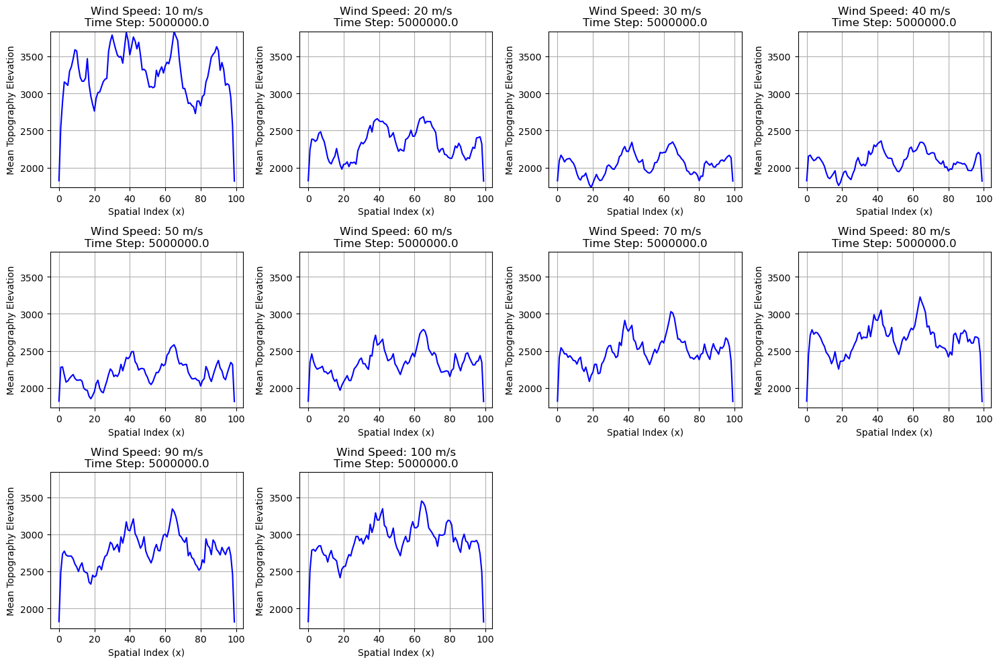

In [50]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Adjust number of rows and columns based on valid wind speeds
n_valid = len(valid_wind_speeds)
ncols = 4  # Define the number of columns
nrows = (n_valid // ncols) + (1 if n_valid % ncols != 0 else 0)  # Calculate rows needed

# Create subplots dynamically based on valid wind speeds
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 10))

# Flatten axes to make indexing easier if there are multiple rows and columns
axes = axes.flatten()

# Initialize variables to track the global min and max for consistent y-axis scaling
global_min_elevation = np.inf
global_max_elevation = -np.inf

# First, loop to find the global min and max of the mean topography elevations
for wind_speed in valid_wind_speeds:
    # Get the mean elevation for this wind speed at the last time step
    elevation_data = combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    
    # Update global min and max
    global_min_elevation = min(global_min_elevation, elevation_data.min())
    global_max_elevation = max(global_max_elevation, elevation_data.max())

# Plot only for valid wind speeds
for idx, wind_speed in enumerate(valid_wind_speeds):
    ax = axes[idx]
    time_step = str(combined_ds.time[-1].values)  # Extract the last time step value
    title = f"Wind Speed: {wind_speed} m/s\nTime Step: {time_step}"
    
    # Get the mean elevation for this wind speed at the last time step
    elevation_data = combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    
    # Plot the elevation data as a line plot
    ax.plot(elevation_data, label='Mean Topography Elevation', color='blue')
    
    # Set the title with wind speed and time step information
    ax.set_title(title)
    
    # Set y-axis label
    ax.set_ylabel("Mean Topography Elevation")
    
    # Set x-axis label
    ax.set_xlabel("Spatial Index (x)")

    # Set consistent y-axis scale
    ax.set_ylim(global_min_elevation, global_max_elevation)
    
    # Add grid for better readability
    ax.grid(True)

# Hide unused axes
for ax in axes[len(valid_wind_speeds):]:
    ax.axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


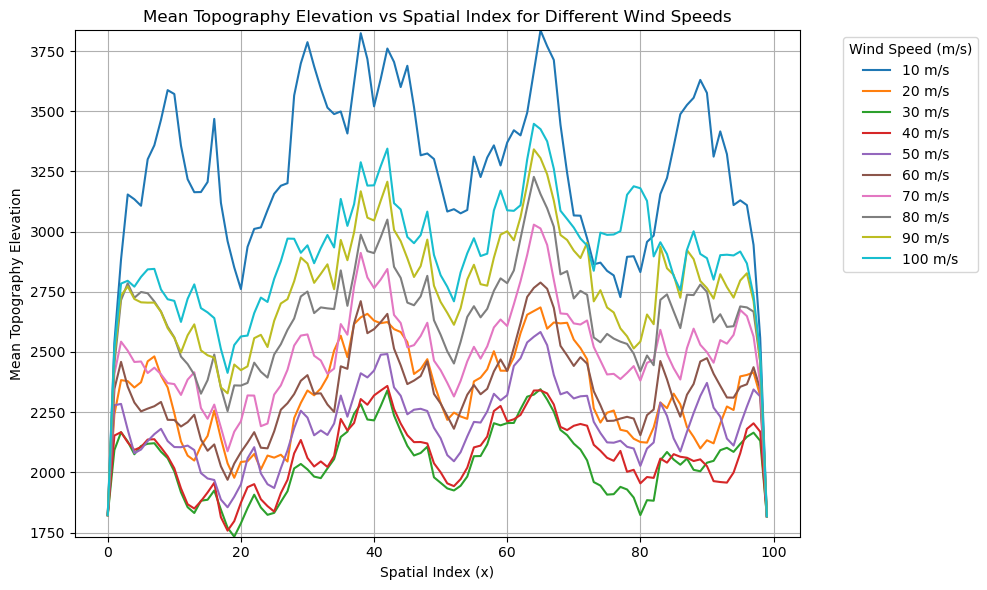

In [51]:
import os
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Filter the wind speeds to only include the desired ones (10, 20, ..., 100 m/s)
desired_wind_speeds = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
combined_ds = combined_ds.sel(wind_speed=np.isin(combined_ds.wind_speed, desired_wind_speeds))

# Create a list of the wind speeds that have data at the last time step
valid_wind_speeds = []
for wind_speed in desired_wind_speeds:
    if not combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).isnull().all():
        valid_wind_speeds.append(wind_speed)

# Initialize variables to track the global min and max for consistent y-axis scaling
global_min_elevation = np.inf
global_max_elevation = -np.inf

# First, loop to find the global min and max of the mean topography elevations
for wind_speed in valid_wind_speeds:
    # Get the mean elevation for this wind speed at the last time step
    elevation_data = combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    
    # Update global min and max
    global_min_elevation = min(global_min_elevation, elevation_data.min())
    global_max_elevation = max(global_max_elevation, elevation_data.max())

# Create a single plot with each wind speed as a line
plt.figure(figsize=(10, 6))

for wind_speed in valid_wind_speeds:
    # Get the mean elevation for this wind speed at the last time step
    elevation_data = combined_ds.topography__elevation.isel(time=-1).sel(wind_speed=wind_speed).mean(dim='x')
    
    # Plot the elevation data as a line plot
    plt.plot(elevation_data, label=f'{wind_speed} m/s')

# Set plot title and labels
plt.title("Mean Topography Elevation vs Spatial Index for Different Wind Speeds")
plt.xlabel("Spatial Index (x)")
plt.ylabel("Mean Topography Elevation")
plt.legend(title="Wind Speed (m/s)", bbox_to_anchor=(1.05, 1), loc='upper left')

# Set consistent y-axis scale
plt.ylim(global_min_elevation, global_max_elevation)

# Add grid for better readability
plt.grid(True)

# Adjust layout for better visualization
plt.tight_layout()

# Show the plot
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


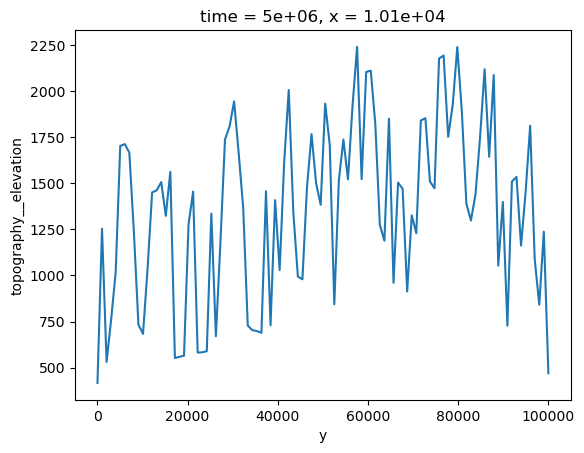

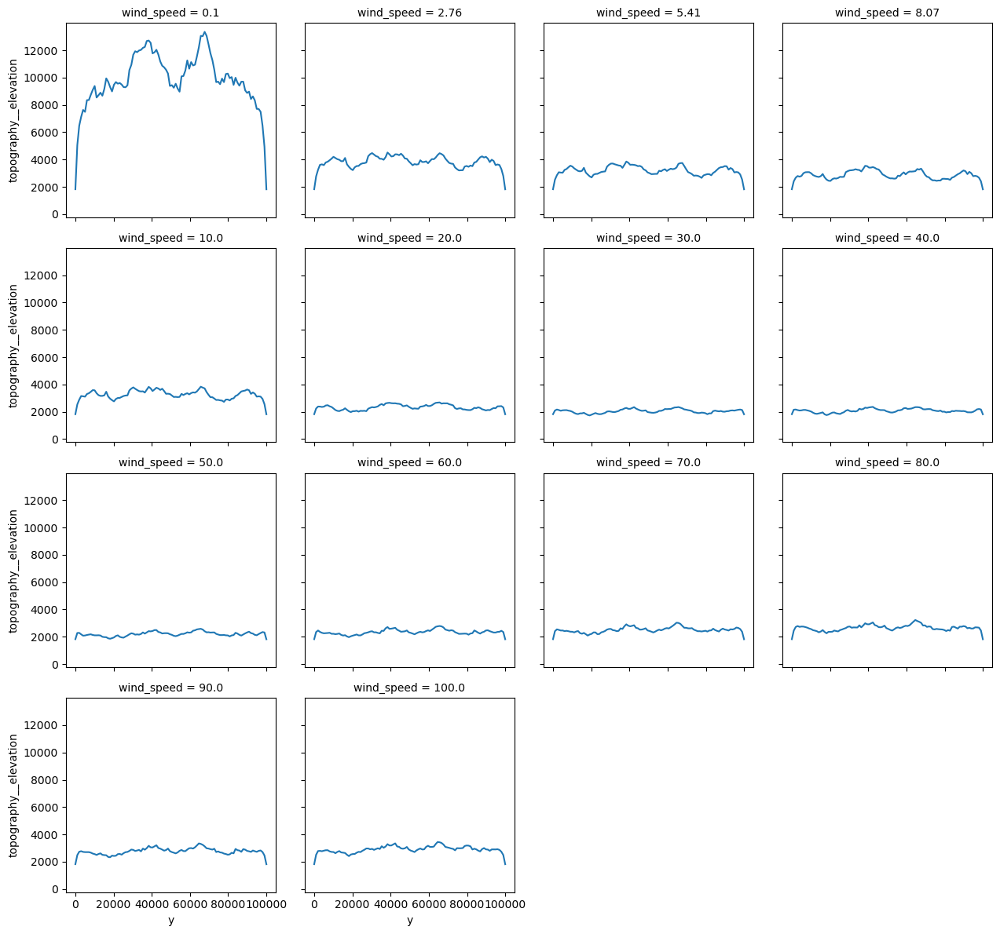

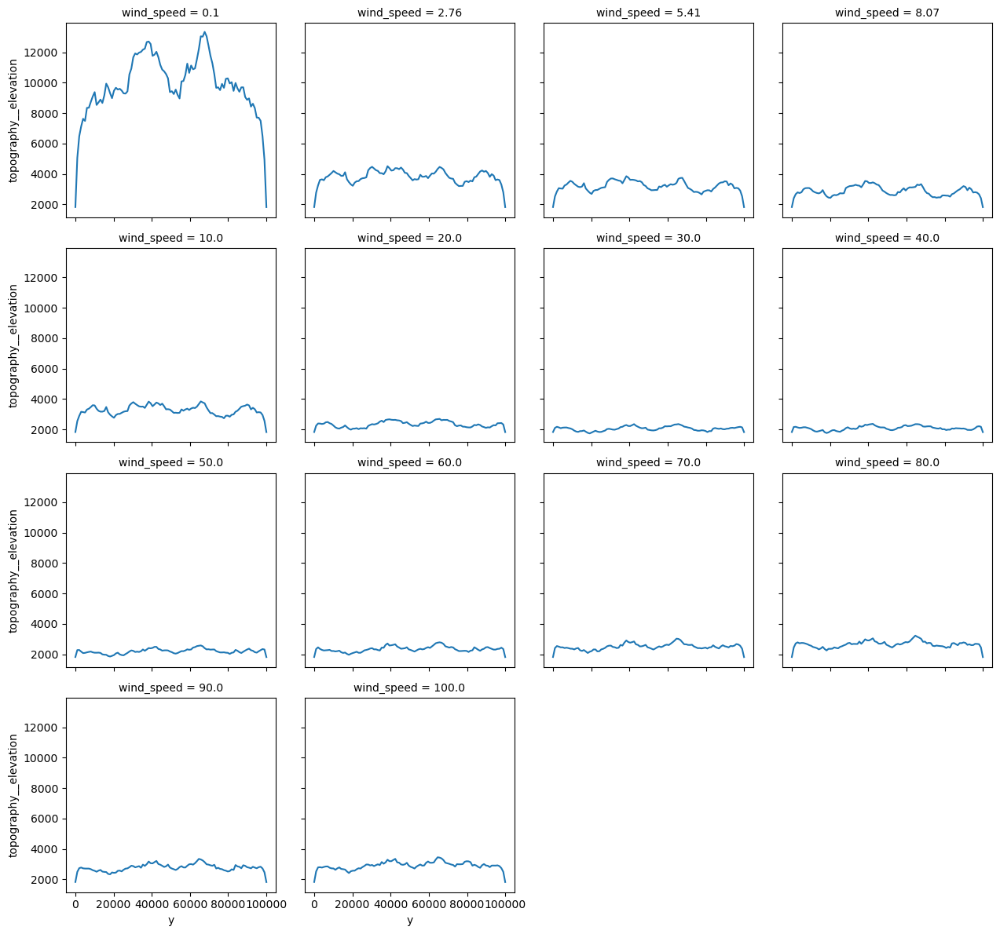

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

# Interactive elevation map
elevation_plot = combined_ds.topography__elevation.hvplot.image(
    x='x', y='y', cmap='viridis', groupby=['time', 'wind_speed']
)
elevation_plot

# Compute and plot mean elevation over wind speed
avg_elevation = combined_ds.topography__elevation.mean(dim='wind_speed')

# Fix: Use method="nearest" to avoid KeyError
avg_elevation.isel(time=-1).sel(x=10000, method="nearest").plot()

# Plot mean elevation at the last time step across different wind speeds
(combined_ds
 .topography__elevation.isel(time=-1)  # Select last time step
 .mean(dim='x')  # Average over 'x' axis
 .plot(col='wind_speed', col_wrap=4)  # Plot for each wind speed
)

# Ensure the plots are displayed
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


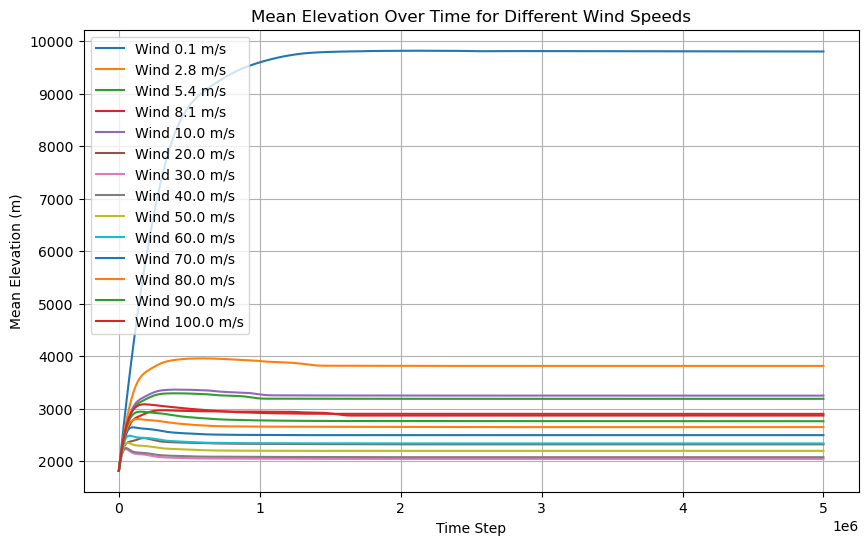

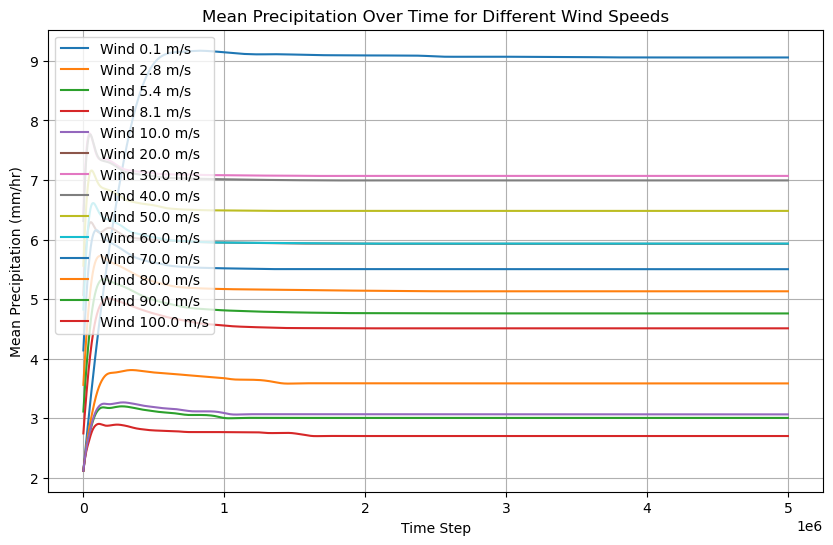

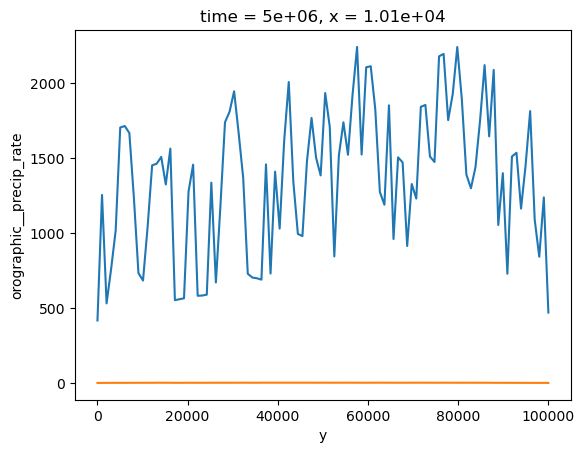

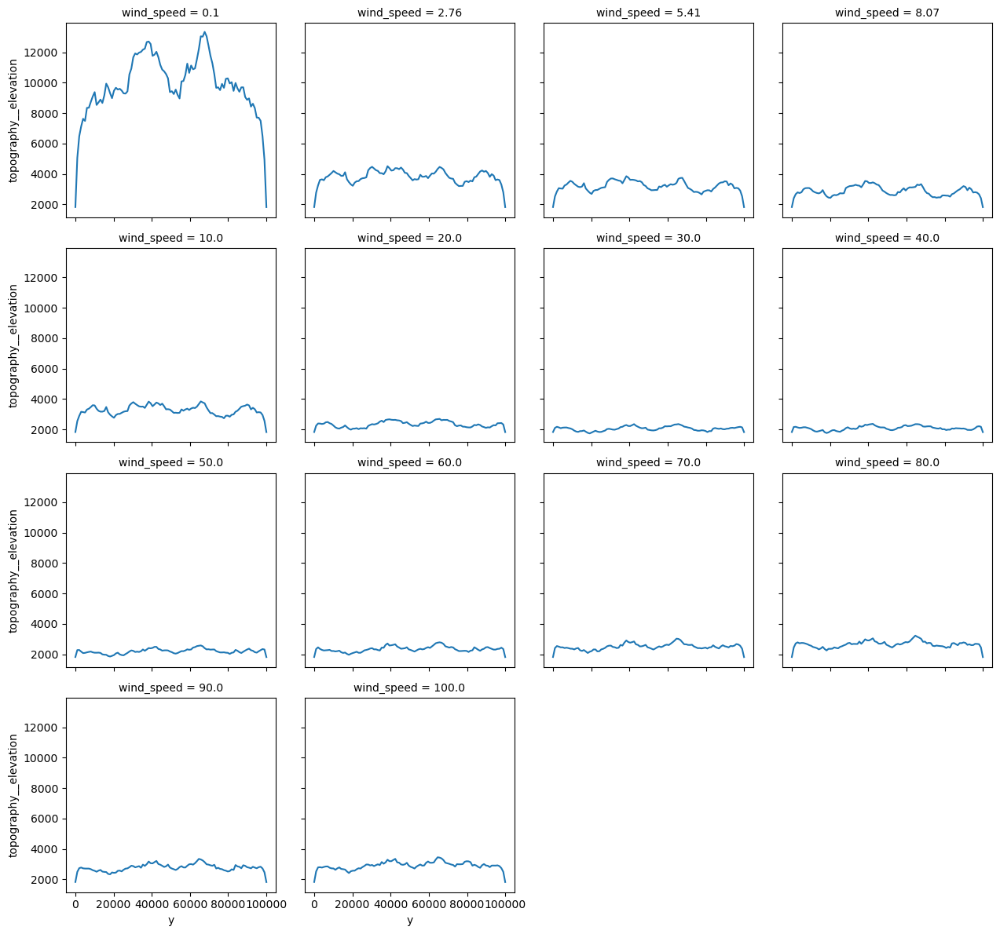

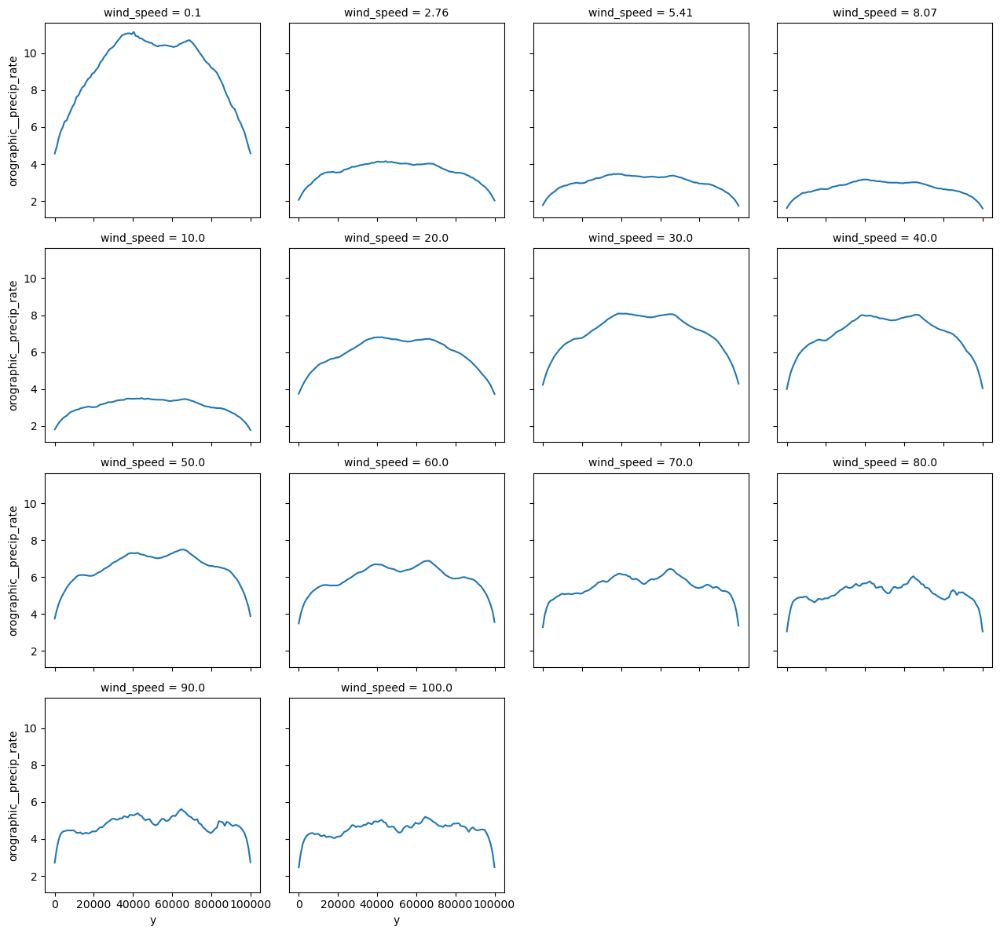

In [ ]:
import os
import numpy as np
import xarray as xr
import hvplot.xarray  # For interactive plotting
import matplotlib.pyplot as plt
import dask

# Directory containing Zarr files
output_dir = "simulation_outputs"

# List all Zarr files and sort by wind speed
zarr_files = [f for f in os.listdir(output_dir) if f.endswith(".zarr")]
zarr_files.sort(key=lambda f: float(f.split("_")[-1][:-5]))

# Load datasets and attach wind_speed as a coordinate
datasets = []
wind_speeds = []
for zarr_file in zarr_files:
    wind_speed = float(zarr_file.split("_")[-1][:-5])  # Extract wind speed from filename
    ds = xr.open_zarr(os.path.join(output_dir, zarr_file), chunks={})
    
    # Add wind_speed as a coordinate
    ds = ds.assign_coords(wind_speed=wind_speed)
    
    datasets.append(ds)
    wind_speeds.append(wind_speed)

# Concatenate datasets along the new wind_speed dimension
combined_ds = xr.concat(datasets, dim="wind_speed")

# Ensure wind_speed is a dimension and coordinate
combined_ds = combined_ds.sortby("wind_speed")

### 📌 Plot 1: Mean Elevation Over Time for Different Wind Speeds
plt.figure(figsize=(10, 6))
for ds, wind_speed in zip(datasets, wind_speeds):
    mean_elevation = ds["topography__elevation"].mean(dim=("x", "y"))
    plt.plot(ds["time"], mean_elevation, label=f"Wind {wind_speed:.1f} m/s")

plt.xlabel("Time Step")
plt.ylabel("Mean Elevation (m)")
plt.title("Mean Elevation Over Time for Different Wind Speeds")
plt.legend()
plt.grid()
plt.show()

### 📌 Plot 2: Mean Precipitation Over Time for Different Wind Speeds
plt.figure(figsize=(10, 6))
for ds, wind_speed in zip(datasets, wind_speeds):
    mean_precip = ds["orographic__precip_rate"].mean(dim=("x", "y"))
    plt.plot(ds["time"], mean_precip, label=f"Wind {wind_speed:.1f} m/s")

plt.xlabel("Time Step")
plt.ylabel("Mean Precipitation (mm/hr)")
plt.title("Mean Precipitation Over Time for Different Wind Speeds")
plt.legend()
plt.grid()
plt.show()

# Compute and plot mean elevation over wind speed
avg_elevation = combined_ds.topography__elevation.mean(dim='wind_speed')

# Fix: Use method="nearest" to avoid KeyError
avg_elevation.isel(time=-1).sel(x=10000, method="nearest").plot()

# Compute and plot mean precipitation over wind speed
avg_precip = combined_ds.orographic__precip_rate.mean(dim='wind_speed')

# Fix: Use method="nearest" to avoid KeyError
avg_precip.isel(time=-1).sel(x=10000, method="nearest").plot()

### 📌 Plot 3: Mean Elevation Across Wind Speeds at Final Time Step
(combined_ds
 .topography__elevation.isel(time=-1)  # Select last time step
 .mean(dim='x')  # Average over 'x' axis
 .plot(col='wind_speed', col_wrap=4)  # Plot for each wind speed
)

### 📌 Plot 4: Mean Precipitation Across Wind Speeds at Final Time Step
(combined_ds
 .orographic__precip_rate.isel(time=-1)  # Select last time step
 .mean(dim='x')  # Average over 'x' axis
 .plot(col='wind_speed', col_wrap=4)  # Plot for each wind speed
)

# Ensure the plots are displayed
plt.show()

# Close all datasets
for ds in datasets:
    ds.close()


In [ ]:
import os

# Directory to save Zarr files
output_dir = "simulation_outputs"
os.makedirs(output_dir, exist_ok=True)

# Define wind_speed values to test
wind_speed_values = np.linspace(10, 100, 10)  # 10 to 100

# Time steps to visualize
time_indices = [0, 1, 10, 100, 1000, 10000]
mean_elevations = []

# Loop through wind_speed values and run simulations
for wind_speed in wind_speed_values:
    print(f"Running simulation for wind_speed = {wind_speed} m/s")
    
    # Set up the model with the current wind_speed (same as before)
    in_ds_winds = xs.create_setup(
        model=SouthernAndesLEM,
        clocks={
            'time': ModelTime_1,
            'output': ModelTime_1[::PlotStep]
        },
        master_clock='time',
        input_vars={
            'grid': {'shape': [nx, ny], 'length': [xl, yl]},
            'boundary': {'status': BoundaryCondition},
            'topography': {'elevation': RotatedTopography_2D},
            'bedrock': {'elevation': RotatedTopography_2D},
            'uplift': {'rate': RotatedUpliftRates_2D},
            'spl': {'k_coef': k_coef, 'area_exp': area_exp, 'slope_exp': slope_exp},
            'diffusion': {'diffusivity': diffusion_diffusivity},
            'orographic': {
                'lapse_rate': lapse_rate,
                'lapse_rate_m': lapse_rate_m,
                'ref_density': ref_density,
                'rainfall_frequency': rainfall_frequency,
                'latitude': latitude,
                'precip_base': precip_base,
                'wind_speed': wind_speed,  # Change wind speed
                'wind_dir': wind_dir,
                'precip_min': precip_min,
                'conv_time': conv_time,
                'fall_time': fall_time,
                'nm': nm,
                'hw': hw,
            },
        },
        output_vars={'topography__elevation': 'time', 'orographic__precip_rate': 'time'}
    )

    # Run the simulation
    with xs.monitoring.ProgressBar():
        out_ds_winds = in_ds_winds.xsimlab.run(model=SouthernAndesLEM)
    
    # Store simulation results in Zarr format
    zarr_filename = os.path.join(output_dir, f"simulation_wind_speed_{wind_speed:.2f}.zarr")
    out_ds_winds.to_zarr(zarr_filename, mode='w')
    print(f"Saved results for wind_speed = {wind_speed} m/s to {zarr_filename}")


Running simulation for wind_speed = 10.0 m/s


             0% | initialize 

Saved results for wind_speed = 10.0 m/s to simulation_outputs/simulation_wind_speed_10.00.zarr
Running simulation for wind_speed = 20.0 m/s


             0% | initialize 

Saved results for wind_speed = 20.0 m/s to simulation_outputs/simulation_wind_speed_20.00.zarr
Running simulation for wind_speed = 30.0 m/s


             0% | initialize 

Saved results for wind_speed = 30.0 m/s to simulation_outputs/simulation_wind_speed_30.00.zarr
Running simulation for wind_speed = 40.0 m/s


             0% | initialize 

Saved results for wind_speed = 40.0 m/s to simulation_outputs/simulation_wind_speed_40.00.zarr
Running simulation for wind_speed = 50.0 m/s


             0% | initialize 

Saved results for wind_speed = 50.0 m/s to simulation_outputs/simulation_wind_speed_50.00.zarr
Running simulation for wind_speed = 60.0 m/s


             0% | initialize 

Saved results for wind_speed = 60.0 m/s to simulation_outputs/simulation_wind_speed_60.00.zarr
Running simulation for wind_speed = 70.0 m/s


             0% | initialize 

Saved results for wind_speed = 70.0 m/s to simulation_outputs/simulation_wind_speed_70.00.zarr
Running simulation for wind_speed = 80.0 m/s


             0% | initialize 

Saved results for wind_speed = 80.0 m/s to simulation_outputs/simulation_wind_speed_80.00.zarr
Running simulation for wind_speed = 90.0 m/s


             0% | initialize 

Saved results for wind_speed = 90.0 m/s to simulation_outputs/simulation_wind_speed_90.00.zarr
Running simulation for wind_speed = 100.0 m/s


             0% | initialize 

Saved results for wind_speed = 100.0 m/s to simulation_outputs/simulation_wind_speed_100.00.zarr
